In [1]:
import os
os.chdir(os.environ['PROJECT_ROOT'])

In [2]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import lightgbm as lgb
import shap
import copy
from lightgbm import LGBMRegressor
from pathlib import Path
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import cross_validate, TimeSeriesSplit
from mentorship.features.kaggle.storesales.etl import ETLTransformer
from mentorship.features.history import cut_history
from mentorship.ml.cv.kaggle.storesales.split import DateTimeSeriesSplit
from mentorship.ml.cv.util import format_cv_test_scores
from mentorship.ml.models.kaggle.storesales.hyperparams.tuning import tune_hyperparams
from mentorship.ml.models.kaggle.storesales.boosting import LGBMPipeline
from mentorship.ml.models.kaggle.storesales.linear import LinearPipeline
from mentorship.ml.models.common import RecursiveTSEstimator



%matplotlib inline
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)

In [3]:
pd.options.mode.chained_assignment = None  # default='warn'

In [4]:
CV_METRICS = [
    'neg_mean_squared_log_error',
    'neg_root_mean_squared_error',
    'neg_mean_absolute_error',
    'r2'
]

In [5]:
DATA_ROOT = Path('data', 'kaggle', 'store-sales-time-series-forecasting')

In [6]:
train = pd.read_csv(DATA_ROOT / 'train.csv')
train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [7]:
N_STORES = train['store_nbr'].nunique()
N_FAMILIES = train['family'].nunique()
N_TIME_SERIES = N_STORES * N_FAMILIES

DAYS_IN_YEAR = 365
N_HORIZONS = 16


# Best model

#### Features: 'store_nbr' (categorical), 'dcoilwtico', 'onpromotion', 'lag'-features (1, 2, 4, 6, 7, 14)
#### Models: LinearRegression, LGBMRegressor (depends on the family)
#### Loss function: MSLE
#### 'zero'-categories: 'baby care', 'books' -- predict constant zero

In [8]:
# preparing the train set

lags = [1, 2, 4, 6, 7, 14]

X = train.copy()

train_transformer = ETLTransformer(lags=lags, target_col='sales')
X, y = train_transformer.transform(X)
splitter = DateTimeSeriesSplit()

X_train, y_train = cut_history(X=X, date_column='date', keep_interval=pd.Timedelta(days=DAYS_IN_YEAR), y=y)

X.head()

,date,store_nbr,family,sales,onpromotion,dcoilwtico,sales_lag_1,sales_lag_2,sales_lag_4,sales_lag_6,sales_lag_7,sales_lag_14
0,2013-01-01,1,automotive,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2013-01-01,1,baby care,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2013-01-01,1,beauty,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2013-01-01,1,beverages,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2013-01-01,1,books,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
# preparing the test set

test_data = pd.read_csv(DATA_ROOT / 'test.csv')
test_transformer = ETLTransformer(is_test=True)
test_data = test_transformer.transform(test_data)
test_data.head()

,date,store_nbr,family,onpromotion,dcoilwtico
0,2017-08-16,1,automotive,0,46.8
1,2017-08-16,1,baby care,0,46.8
2,2017-08-16,1,beauty,2,46.8
3,2017-08-16,1,beverages,20,46.8
4,2017-08-16,1,books,0,46.8


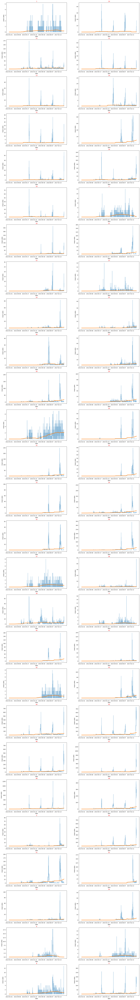

In [10]:
# 'school and office supplies' mean sales for each 'store_nbr'

plt.figure(figsize=(20, 150))
X_school = X.loc[X['family'] == 'school and office supplies', :]
X_school['sales'] = np.expm1(X_school['sales'])
for i, store_nbr in enumerate(X['store_nbr'].unique()):
    plt.subplot(27, 2, i + 1)
    average_sales = X_school.loc[X_school['store_nbr'] == store_nbr, :].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(store_nbr, color='red')

In [11]:
# importing best cross-validation and final params
import json

with open(DATA_ROOT / 'best_cv_params.txt') as f:
    data = f.read()
best_cv_params = json.loads(data)

with open(DATA_ROOT / 'best_final_params.txt') as f:
    data = f.read()
best_final_params = json.loads(data)

#### Compare scores for every family

In [12]:
base_pipelines = {}
linear_categories = ['baby care', 'books', 'lawn and garden', 'home appliances']
zero_categories = ['baby care', 'books']
fit_params = {'categorical_feature': [0]}

for current_family in X['family'].unique():
    if current_family in linear_categories:
        base_pipelines[current_family] = LinearPipeline(cols_to_scale=['dcoilwtico'], cols_to_encode=['store_nbr'], 
                                                        drop_columns=['onpromotion'], lags=lags, split_key='family', 
                                                        target_col='sales')
    else:
        base_pipelines[current_family] = LGBMPipeline(lags=lags, split_key='family', target_col='sales', 
                                                      fit_params=fit_params, params=best_cv_params[current_family])

In [13]:
scores_for_every_family = {}
tscv = TimeSeriesSplit(gap=0, max_train_size=DAYS_IN_YEAR * N_STORES, n_splits=4, test_size=N_HORIZONS * N_STORES)

for current_family in X['family'].unique():
    X_current_family = X[X['family'] == current_family]
    y_current_family = y.loc[X_current_family.index]
    
    base_pipeline = {current_family:base_pipelines[current_family]}
    modelling_pipeline = RecursiveTSEstimator(base_pipelines=base_pipeline, split_key='family', 
                                              target_col='sales', zero_categories=zero_categories)
    
    scores = cross_validate(modelling_pipeline, X_current_family, y_current_family, cv=tscv, scoring=CV_METRICS, 
                            return_estimator=True, error_score='raise', n_jobs=-1)

    scores_for_every_family[current_family] = format_cv_test_scores(scores, save_scores=True, print_scores=False)

In [14]:
def plot_scores_for_every_feature_value(scores, feature):
    rmsle_for_every_feature_value = {}
    for key in scores.keys():
        rmsle_for_every_feature_value[key] = round(scores[key][0]['root_mean_squared_log_error'], 3)

    sorted_rmsle_for_every_feature_value = {str(k): v for k, v in sorted(rmsle_for_every_feature_value.items(), 
                                                                    key=lambda item: item[1], reverse=True)}
    plt.figure(figsize=(20, 5))
    plt.bar(sorted_rmsle_for_every_feature_value.keys(), sorted_rmsle_for_every_feature_value.values())
    plt.xticks(rotation=90)
    plt.axhline(y=0.4185, color='red', linestyle='dashed', label='Kaggle score')
    plt.title(feature)
    plt.legend()
    plt.show()

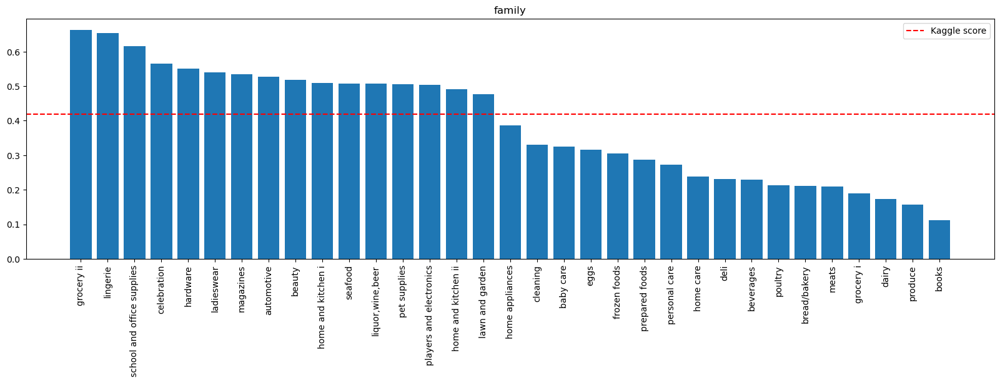

In [15]:
### analyzing metric scores for every 'family'

plot_scores_for_every_feature_value(scores_for_every_family, 'family')

<b><p>1) Model probably makes mistakes in 'grocery ii' category, because of the distribution of its sales (it rises up sharply in last months); in 'school and office supplies' category (there is a period in the last year with extremely high sales, which could affect on the boosting algorithm).</p>
    <p><i>Possible solution:</i> for 'grocery ii' category train the model only on the recent 'high values' data (last months); for 'school and office supplies' use some seasonality tools or other model (Prophet, for example) (it can be seen that sales peaks are seasonal, which is logical for such category).</p></b>

In [16]:
last = next(splitter.split(X, y))
for last in splitter.split(X, y):
    continue
    
train_indices = last[0]

X_train_last_fold, y_train_last_fold = X.iloc[train_indices], y.iloc[train_indices]

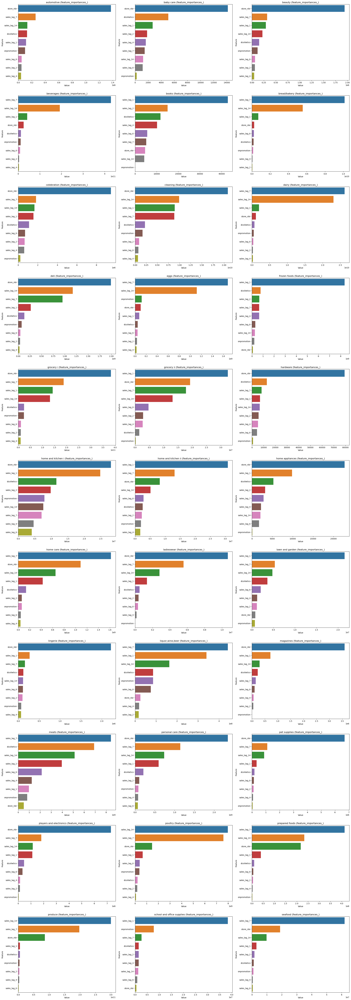

In [17]:
plt.figure(figsize=(30, 90))
for i, current_family in enumerate(X['family'].unique()):
    X_current_family = X_train_last_fold[X_train_last_fold['family'] == current_family].drop(columns=['date', 'sales', 'family'])
    y_current_family = y_train_last_fold.loc[X_current_family.index]
    
    plt.subplot(11, 3, i + 1)
    lgbm_model = lgb.LGBMRegressor(importance_type='gain')
    lgbm_model.fit(X_current_family, y_current_family, categorical_feature=['store_nbr'])
    lgbm_feature_imp = pd.DataFrame(sorted(zip(lgbm_model.feature_importances_, X_current_family.columns)), 
                                    columns=['Value', 'Feature'])
    sns.barplot(x='Value', y='Feature', data=lgbm_feature_imp.sort_values(by='Value', ascending=False))
    plt.title(f'{current_family} (feature_importances_)')

<b><p>2) As we can see on these plots, features 'lag_2', 'lag_4', 'lag_6' aren't very useful in most categories (by LGBM feature_importance). Probably it could be useful to try some categories without some of these 3 features.</p>
   <p>P.S. We don't pay attention to linear categories here.</b>

automotive


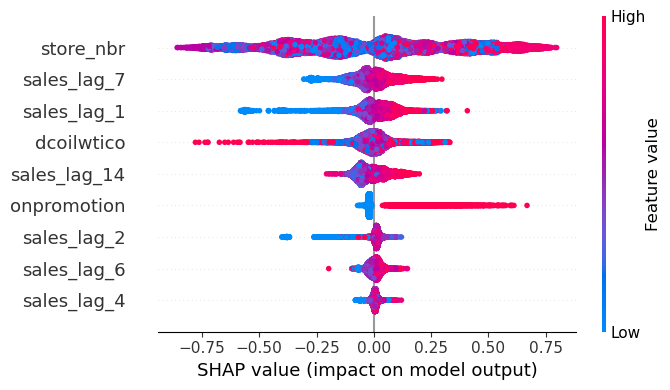

beauty


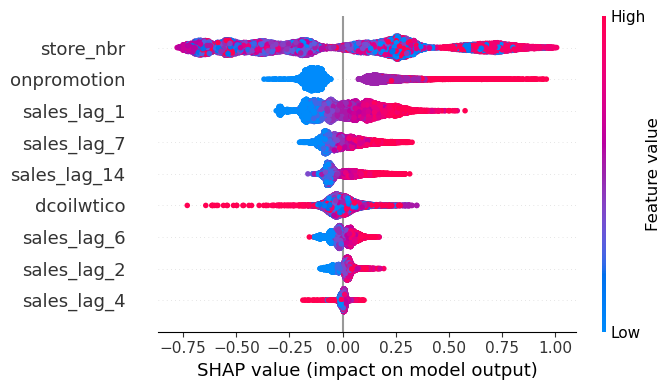

beverages


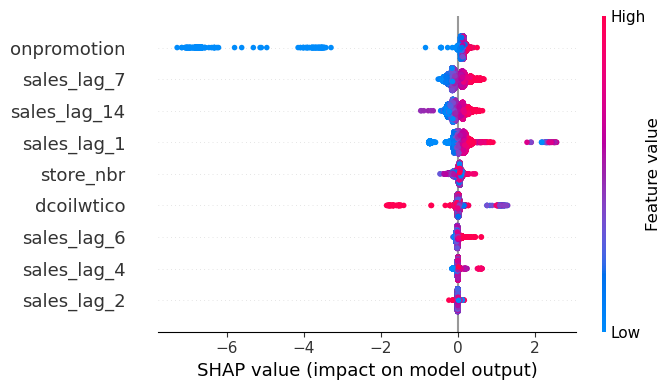

bread/bakery


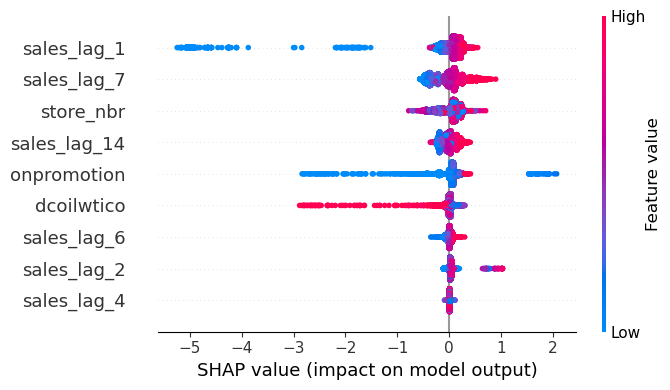

celebration


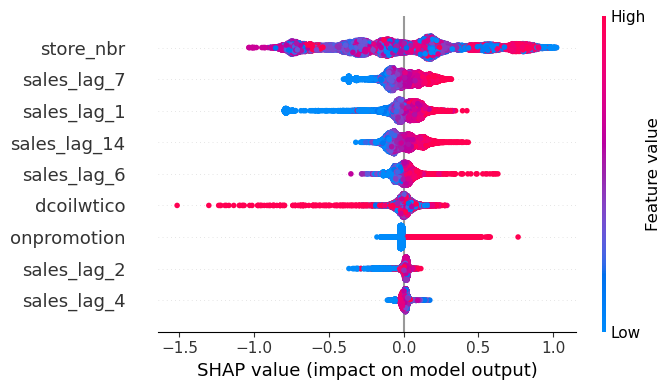

cleaning


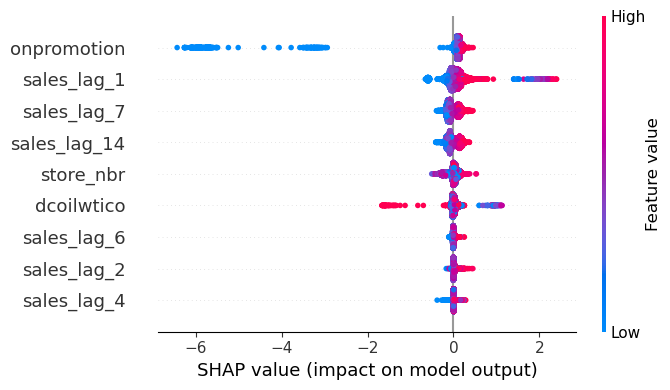

dairy


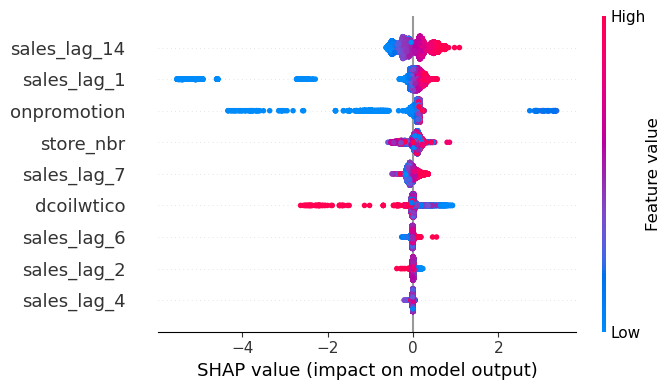

deli


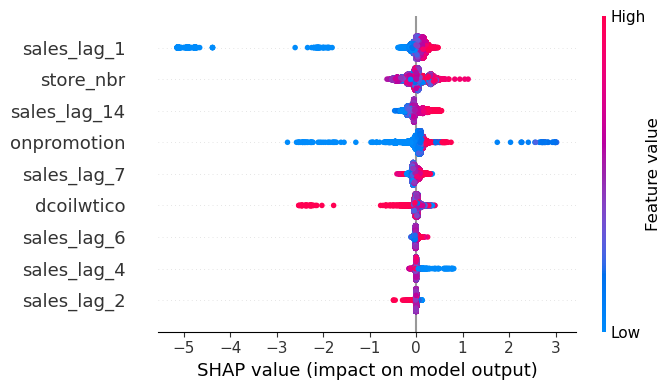

eggs


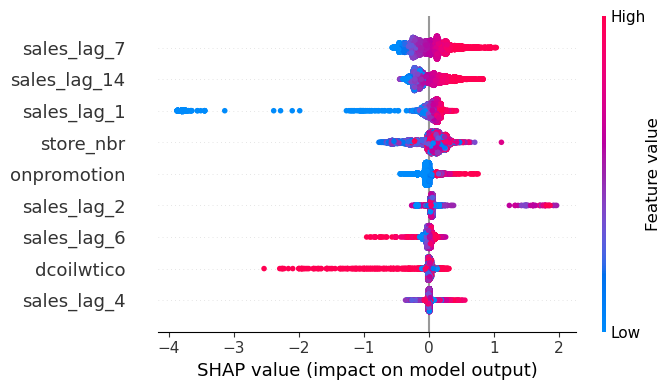

frozen foods


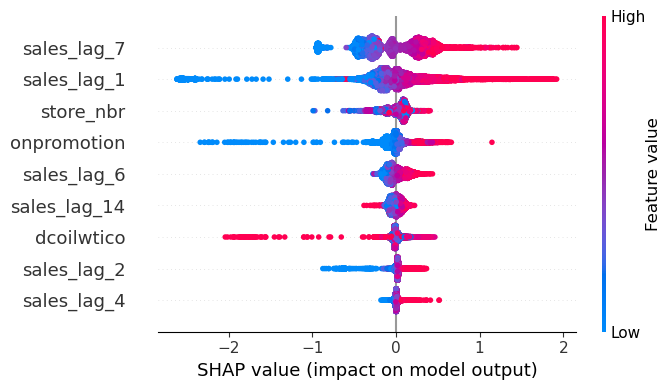

grocery i


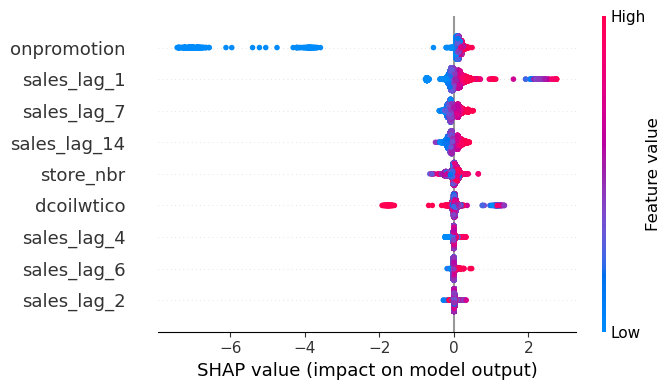

grocery ii


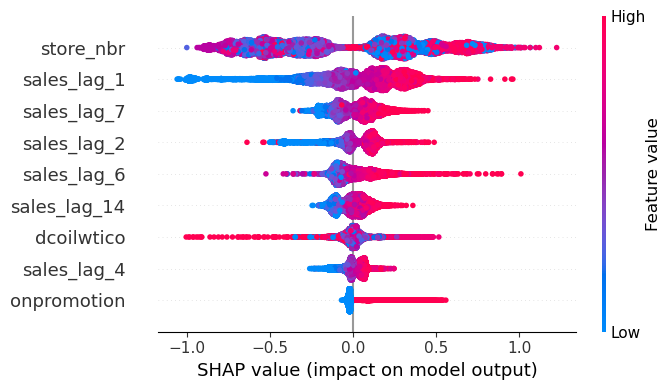

hardware


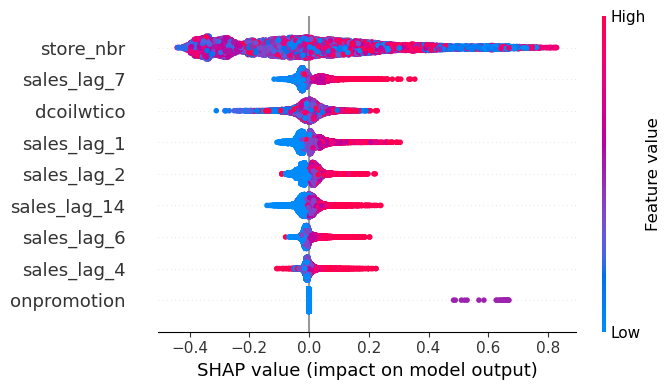

home and kitchen i


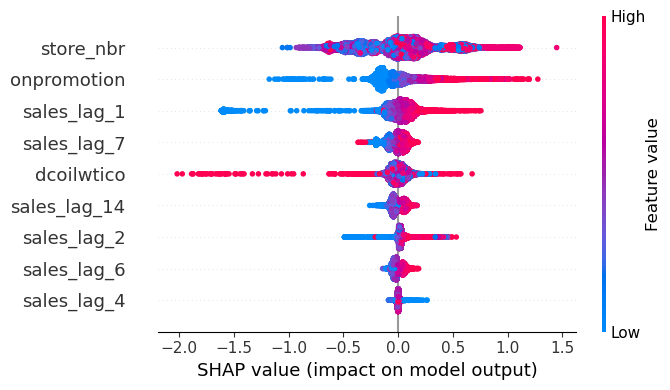

home and kitchen ii


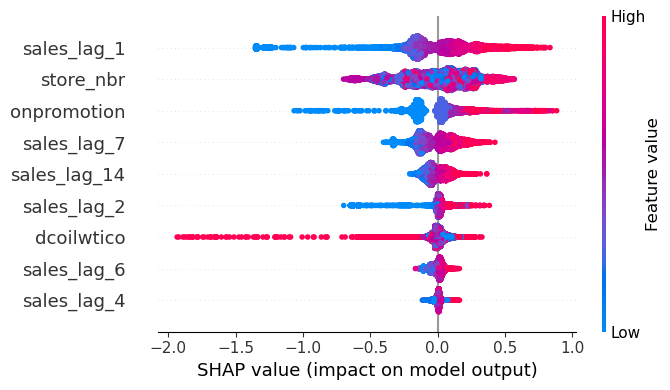

home care


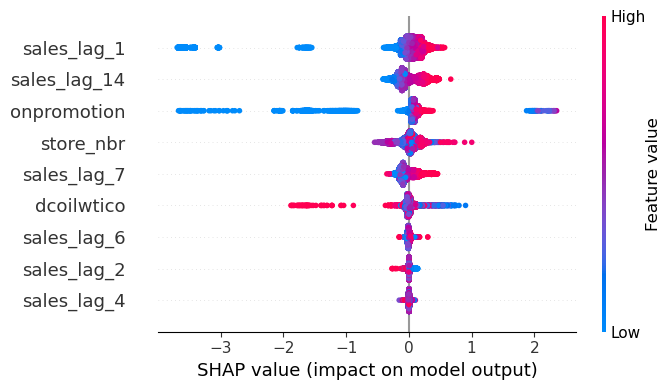

ladieswear


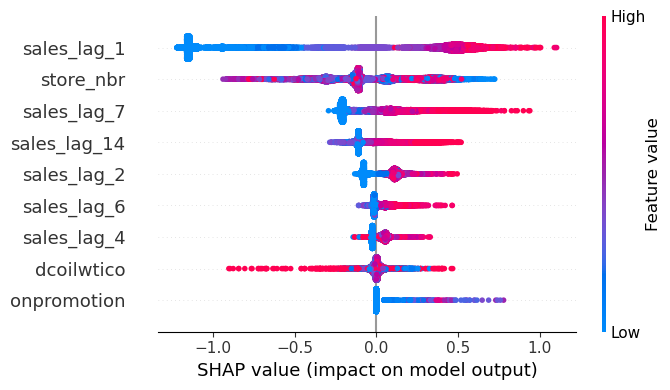

lingerie


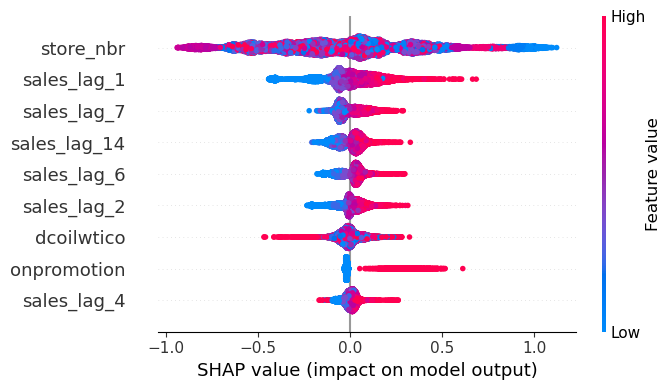

liquor,wine,beer


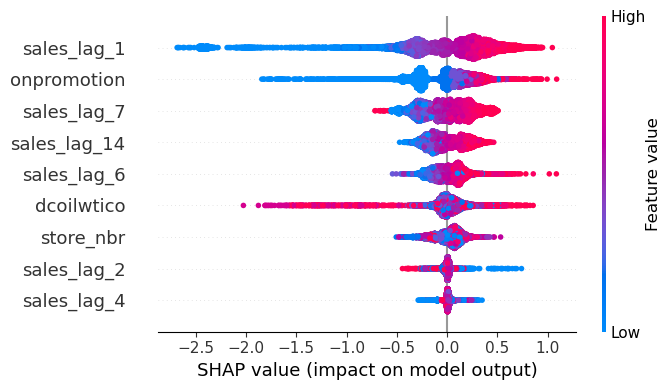

magazines


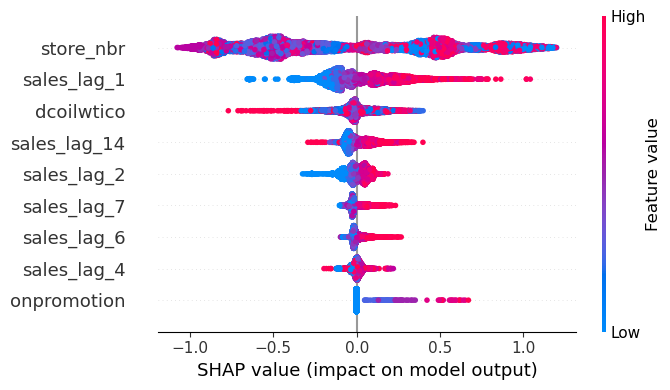

meats


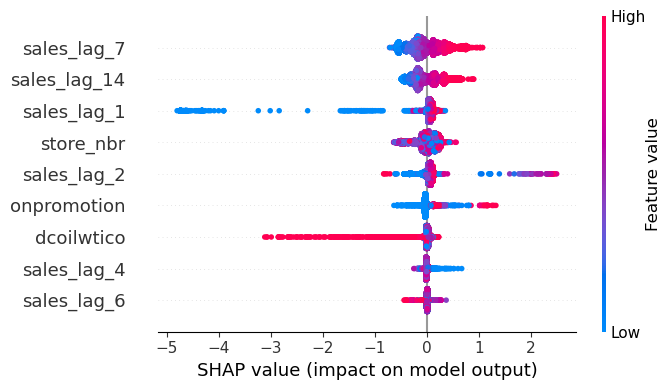

personal care


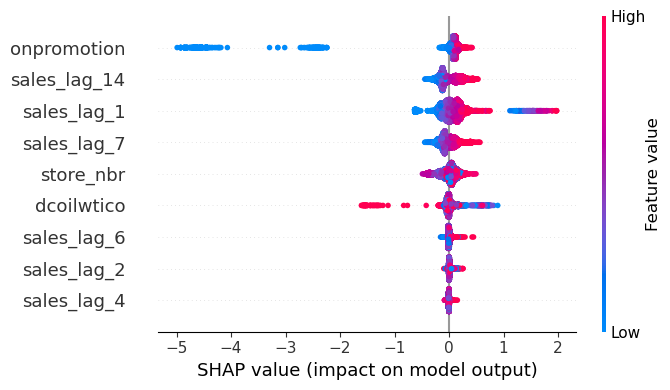

pet supplies


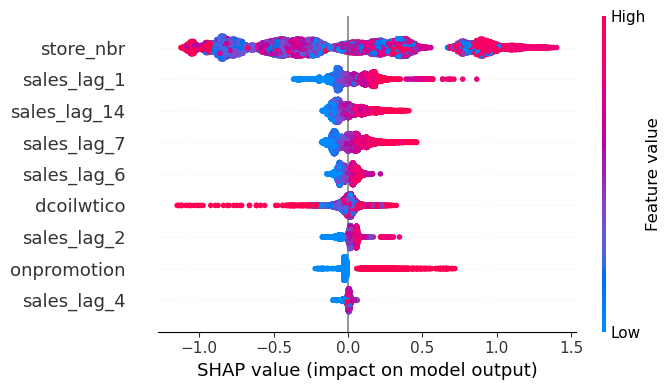

players and electronics


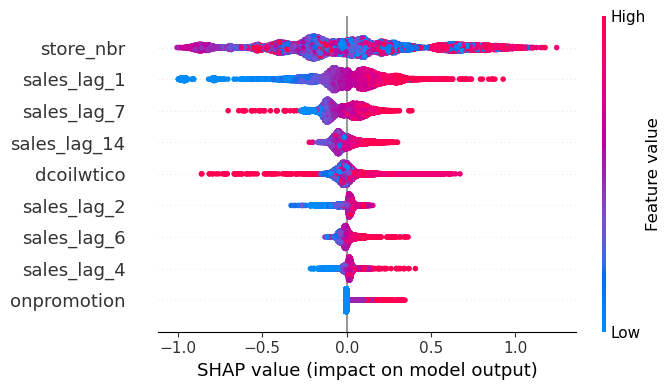

poultry


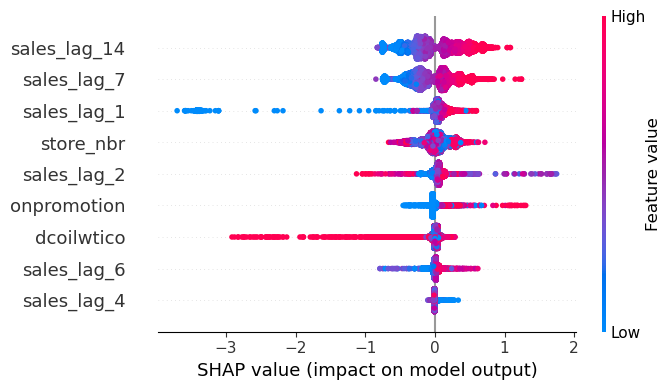

prepared foods


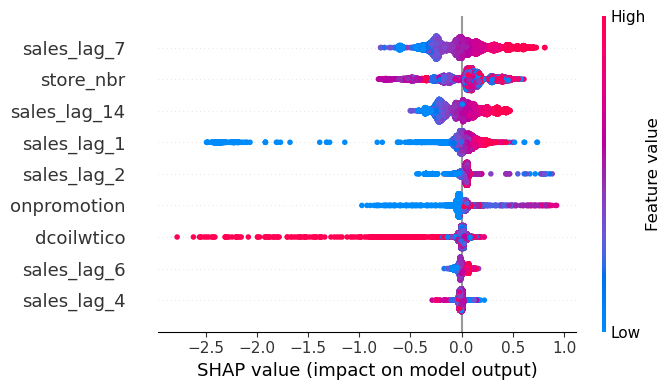

produce


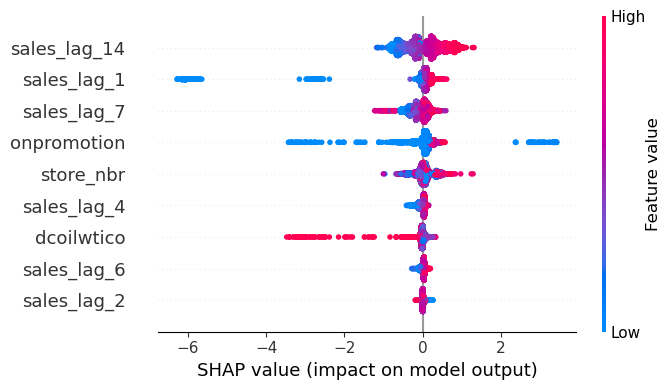

school and office supplies


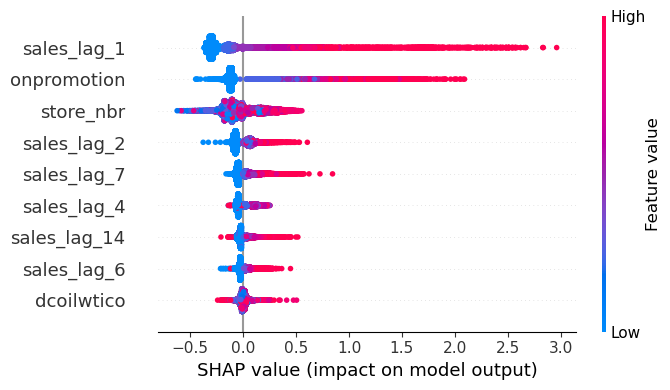

seafood


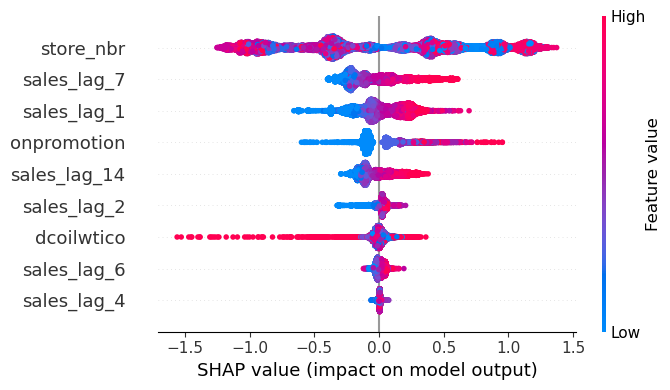

In [18]:
for i, current_family in enumerate([family for family in X['family'].unique() if family not in linear_categories]):
    print(current_family)
    X_current_family = X_train_last_fold[X_train_last_fold['family'] == current_family].drop(columns=['date', 'sales', 'family'])
    y_current_family = y_train_last_fold.loc[X_current_family.index]
    lgbm_model = lgb.LGBMRegressor()
    lgbm_model.fit(X_current_family, np.log1p(y_current_family), categorical_feature=['store_nbr'])
    explainer = shap.TreeExplainer(lgbm_model)
    shap_values_current_family = explainer(X_current_family)
    shap.summary_plot(shap_values_current_family, plot_size=(7, 4))

<b><p>3) Most of 'bad' categories aren't first need goods, whereas most of 'good' categories are first need goods. Because of this fact, one thing about Shap plots becomes clear: most of 'bad' categories have 'store_nbr' feature as the most important (by SHAP), whereas most of 'good' categories don't have such trend. It can be explained in this way: predictions of categories, which can't be named as first need, can be influenced by store (probably, somewhere such goods aren't sold at all), whereas first need goods are sold in most of stores. What can we do with this? Probably it could be helpful to try first need categories without 'store_nbr' feature.</p>
   <p>4) Most of 'good' categories have a lot of samples where low 'onpromotion' values have very low shapley values. It seems logical: less promos -- less sales number. But most of 'bad' categories don't have such tendency. Low values of onpromotion feature mostly have negative shapley values, but not so low as in most of 'good' categories.</p></b>

In [19]:
def scores_for_every_feature_value(X, y, feature, base_pipelines):
    scores_for_every_feature_value = {}
    zero_categories = ['baby care', 'books']
    for current_feature_value in X[feature].unique():
        X_current_feature_value = X[X[feature] == current_feature_value]
        if feature != 'store_nbr':
            X_current_feature_value = X_current_feature_value.drop(columns=[feature])
        y_current_feature_value = y.loc[X_current_feature_value.index]
        
        modelling_pipeline = RecursiveTSEstimator(base_pipelines=base_pipelines, split_key='family', 
                                                  target_col='sales', zero_categories=zero_categories)
    
        scores = cross_validate(modelling_pipeline, X_current_feature_value, y_current_feature_value, cv=splitter, 
                                scoring=CV_METRICS, return_estimator=True, error_score='raise', n_jobs=-1)

        scores_for_every_feature_value[current_feature_value] = format_cv_test_scores(scores, save_scores=True, 
                                                                                      print_scores=False)
    return scores_for_every_feature_value

#### Compare scores for every store_nbr

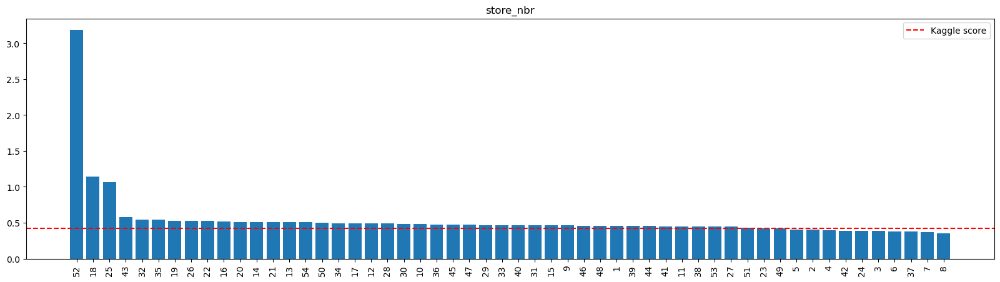

In [20]:
scores_for_every_store_nbr = scores_for_every_feature_value(X, y, feature='store_nbr', base_pipelines=base_pipelines)
plot_scores_for_every_feature_value(scores_for_every_store_nbr, 'store_nbr')

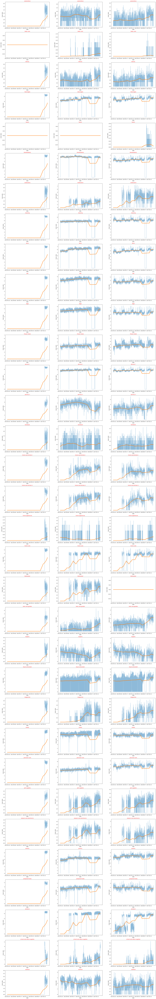

In [21]:
### time series for the "worst" 'store_nbr'

plt.figure(figsize=(30, 200))
for i, family in enumerate(X['family'].unique()):
    plt.subplot(33, 3, 3 * i + 1)
    average_sales = X[(X['family'] == family) & (X['store_nbr'] == 52)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(family, color='red')
    
    plt.subplot(33, 3, 3 * i + 2)
    average_sales = X[(X['family'] == family) & (X['store_nbr'] == 18)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(family, color='red')
    
    plt.subplot(33, 3, 3 * i + 3)
    average_sales = X[(X['family'] == family) & (X['store_nbr'] == 25)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(family, color='red')

<b><p>5) Model makes mistakes in 52-nd store_nbr, because of the distribution of its sales (no data before ~2017 year, probably this store was opened very late); in 18-th, 25-th store_nbr because of no data during some period of time in the last year of observations (there is no such period in other categories).</p>
    <p><i>Possible solution:</i> for 52-nd store_nbr train the model only on the recent non-zero data (since the store was opened), for 18-th, 25-th store_nbr fill 'no-data' samples using some rolling.</p></b>

#### Compare scores for every store_city

In [22]:
X_copy = X.copy()
X_copy = train_transformer.add_store_features(X_copy, columns_to_add=['city'])
X_copy['store_city'] = LabelEncoder().fit_transform(X_copy['store_city']) + 1
X_copy.head()

,date,store_nbr,family,sales,onpromotion,dcoilwtico,sales_lag_1,sales_lag_2,sales_lag_4,sales_lag_6,sales_lag_7,sales_lag_14,store_city
0,2013-01-01,1,automotive,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19
1,2013-01-01,1,baby care,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19
2,2013-01-01,1,beauty,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19
3,2013-01-01,1,beverages,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19
4,2013-01-01,1,books,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19


In [23]:
scores_for_every_store_city = scores_for_every_feature_value(X_copy, y, feature='store_city', base_pipelines=base_pipelines)

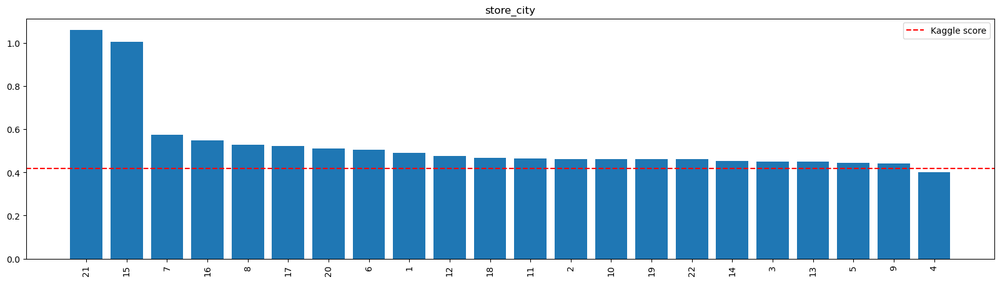

In [24]:
plot_scores_for_every_feature_value(scores_for_every_store_city, 'store_city')

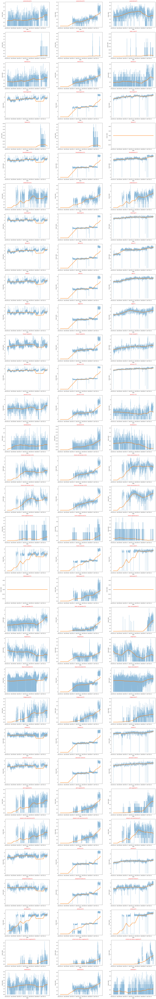

In [25]:
### time series for the "worst" 'store_city'

plt.figure(figsize=(30, 200))
for i, family in enumerate(X_copy['family'].unique()):
    plt.subplot(33, 3, 3 * i + 1)
    average_sales = X_copy[(X_copy['family'] == family) & (X_copy['store_city'] == 21)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(f'{family}(21)', color='red')
    
    plt.subplot(33, 3, 3 * i + 2)
    average_sales = X_copy[(X_copy['family'] == family) & (X_copy['store_city'] == 15)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(f'{family}(15)', color='red')
    
    plt.subplot(33, 3, 3 * i + 3)
    average_sales = X_copy[(X_copy['family'] == family) & (X_copy['store_city'] == 7)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(f'{family}(7)', color='red')

<b><p>6) Big mistakes in 21-st and 15-th store_city can be explained by their distribution: 21-st store_city has some months with missing data (last year), 15-th store_city has an extremely fast sales raising in the last months of observations.</p>
   <p>Possible solution: fill missing data with some rolling for 21-st store_city; use only last months for training for 15-th store_city.</b>

#### Compare scores for every store_cluster

In [26]:
X_copy = X.copy()
X_copy = train_transformer.add_store_features(X_copy, columns_to_add=['cluster'])
X_copy['store_cluster'] = X_copy['store_cluster'] + 1
X_copy.head()

,date,store_nbr,family,sales,onpromotion,dcoilwtico,sales_lag_1,sales_lag_2,sales_lag_4,sales_lag_6,sales_lag_7,sales_lag_14,store_cluster
0,2013-01-01,1,automotive,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13
1,2013-01-01,1,baby care,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13
2,2013-01-01,1,beauty,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13
3,2013-01-01,1,beverages,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13
4,2013-01-01,1,books,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13


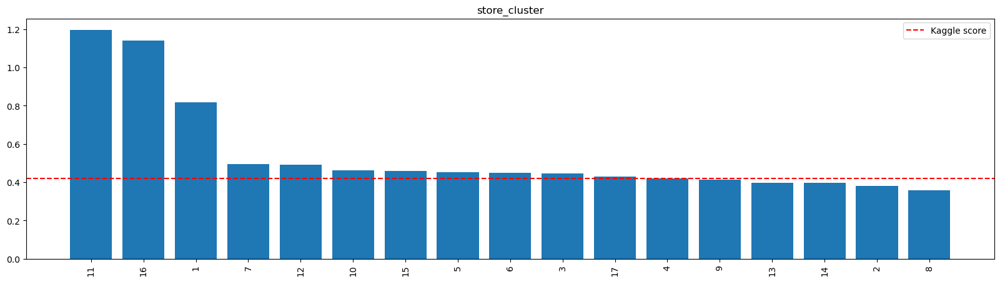

In [27]:
scores_for_every_store_cluster = scores_for_every_feature_value(X_copy, y, feature='store_cluster', base_pipelines=base_pipelines)
plot_scores_for_every_feature_value(scores_for_every_store_cluster, 'store_cluster')

In [28]:
stores_data = pd.read_csv(DATA_ROOT / 'stores.csv')
stores_data['city'] = LabelEncoder().fit_transform(stores_data['city']) + 1
stores_data['type'] = LabelEncoder().fit_transform(stores_data['type']) + 1
stores_data[(stores_data['cluster'] == 11) | (stores_data['cluster'] == 16) | (stores_data['cluster'] == 1)]

,store_nbr,city,state,type,cluster
17,18,19,Pichincha,2,16
23,24,9,Guayas,4,1
24,25,21,Santa Elena,4,1
26,27,5,Guayas,4,1
44,45,19,Pichincha,1,11
48,49,19,Pichincha,1,11
51,52,15,Manabi,1,11


<b><p>7) Big mistakes in some clusters can be explained by the fact that every such cluster has 'bad' 'store_nbr' or 'bad' 'store_city' in their composition. To avoid such mistakes it is necessary to deal with 'store_nbr' and 'store_city' first.</p></b>

## Top-N worst time series

In [29]:
scores_for_every_ts = {}
tscv_every_ts = TimeSeriesSplit(gap=0, max_train_size=DAYS_IN_YEAR, n_splits=4, test_size=N_HORIZONS)

for current_store_nbr in X['store_nbr'].unique():
    for current_family in X['family'].unique():
        X_current_ts = X[(X['store_nbr'] == current_store_nbr) & (X['family'] == current_family)]
        y_current_ts = y.loc[X_current_ts.index]
        
        base_pipeline = {current_family:base_pipelines[current_family]}
        modelling_pipeline = RecursiveTSEstimator(base_pipelines=base_pipeline, split_key='family', 
                                                  target_col='sales', zero_categories=zero_categories)
    
        scores = cross_validate(modelling_pipeline, X_current_ts, y_current_ts, cv=tscv_every_ts, scoring=CV_METRICS, 
                                return_estimator=True, error_score='raise', n_jobs=-1)

        scores_for_every_ts[f'{current_store_nbr}, {current_family}'] = format_cv_test_scores(scores, save_scores=True, 
                                                                                         print_scores=False)

In [30]:
rmsle_scores_every_ts = {k: v[0]['root_mean_squared_log_error'] for k, v in scores_for_every_ts.items()}
rmsle_sorted_scores_every_ts = {k: v for k, v in sorted(rmsle_scores_every_ts.items(), 
                                                        key=lambda item: item[1], reverse=True)}

In [31]:
bad_rmsle_scores_ts = {k: v for k, v in rmsle_sorted_scores_every_ts.items() if v > 0.4185}
bad_rmsle_scores_ts = {tuple(k.split(', ')): v for k, v in bad_rmsle_scores_ts.items()}
print(len(bad_rmsle_scores_ts))

798


In [32]:
# time series with bad store_nbr (explained above)

len([k for k in bad_rmsle_scores_ts.keys() if k[0] in ['52', '18', '25']])

78

In [33]:
bad_rmsle_scores_ts = {k: v for k, v in bad_rmsle_scores_ts.items() if k[0] not in ['52', '18', '25']}

In [34]:
# time series with two bad (and explained why) categories: 'school and office supplies', 'grocery ii'

len([k for k in bad_rmsle_scores_ts.keys() if k[1] in ['school and office supplies', 'grocery ii']])

88

In [35]:
bad_rmsle_scores_ts = {k: v for k, v in bad_rmsle_scores_ts.items() if k[1] not in ['school and office supplies', 'grocery ii']}

In [36]:
# zero categories

print('books:', len([k for k in bad_rmsle_scores_ts.keys() if k[1] == 'books']))
print('baby care:', len([k for k in bad_rmsle_scores_ts.keys() if k[1] == 'baby care']))

books: 0
baby care: 10


In [37]:
bad_rmsle_scores_ts = {k: v for k, v in bad_rmsle_scores_ts.items() if k[1] not in ['books', 'baby care']}

In [38]:
# time series with stores from 'bad' cities (also explained)

stores_data = pd.read_csv(DATA_ROOT / 'stores.csv')
stores_data['city'] = LabelEncoder().fit_transform(stores_data['city'])
len([k for k in bad_rmsle_scores_ts.keys() if int(k[0]) in stores_data[stores_data['city'].isin([21, 15])]['store_nbr'].unique()])

53

In [39]:
bad_rmsle_scores_ts = {k: v for k, v in bad_rmsle_scores_ts.items() if int(k[0]) not in stores_data[stores_data['city'].isin([21, 15])]['store_nbr'].unique()}
len(bad_rmsle_scores_ts)

569

In [40]:
# Let's leave only those time series, where rmsle > 0.66 (because probably these (bigger) mistakes 
# are the most important in those 569 which are left)
# 0.66 is the bigger average mistake by category (lingerie)

bad_rmsle_scores_ts = {k: v for k, v in bad_rmsle_scores_ts.items() if v > 0.66}
len(bad_rmsle_scores_ts)

104

In [41]:
bad_categories = pd.Series([k[1] for k in bad_rmsle_scores_ts.keys()])
bad_categories.value_counts()

lingerie                   20
ladieswear                 15
liquor,wine,beer           12
celebration                11
lawn and garden             9
beauty                      8
seafood                     8
players and electronics     4
home and kitchen ii         3
home and kitchen i          3
magazines                   2
hardware                    2
cleaning                    2
pet supplies                1
automotive                  1
beverages                   1
eggs                        1
prepared foods              1
dtype: int64

In [42]:
bad_rmsle_scores_ts_sorted = {k: v for k, v in sorted(bad_rmsle_scores_ts.items(), 
                                                      key=lambda item: item[0][1])}

43, automotive


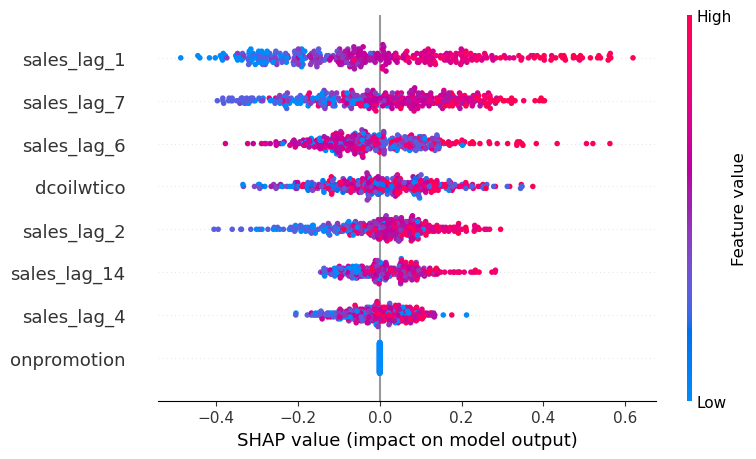

13, beauty


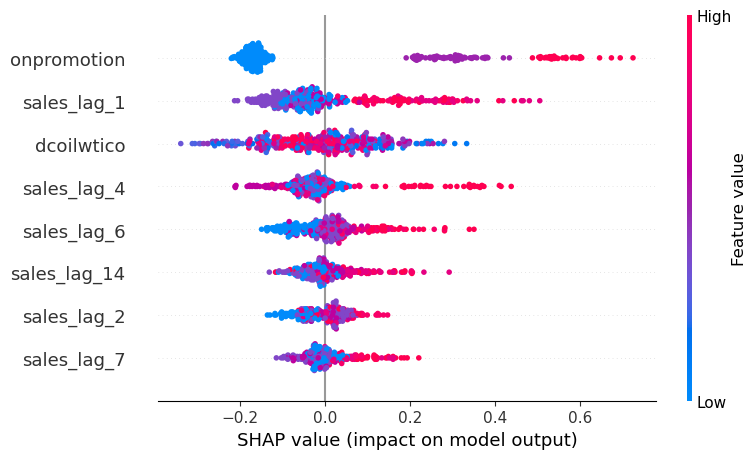

14, beauty


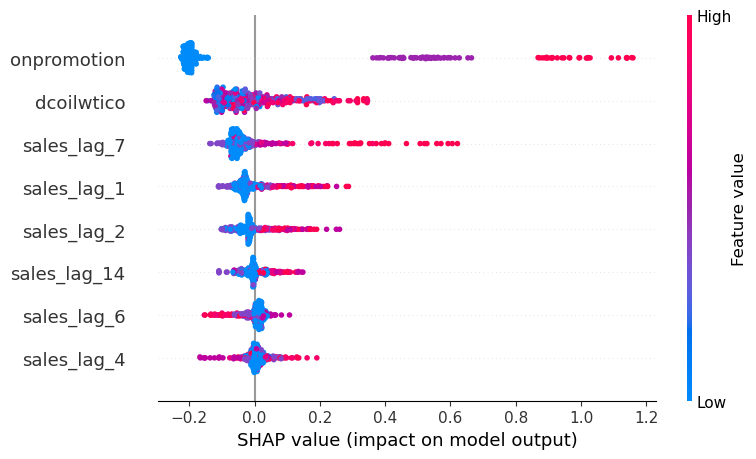

33, beauty


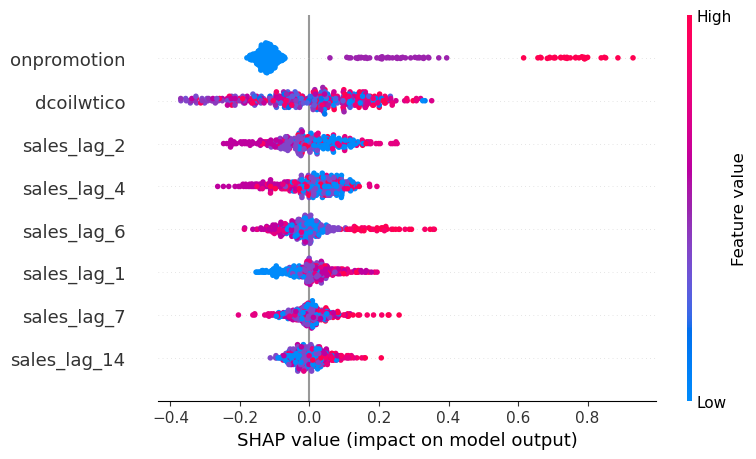

27, beauty


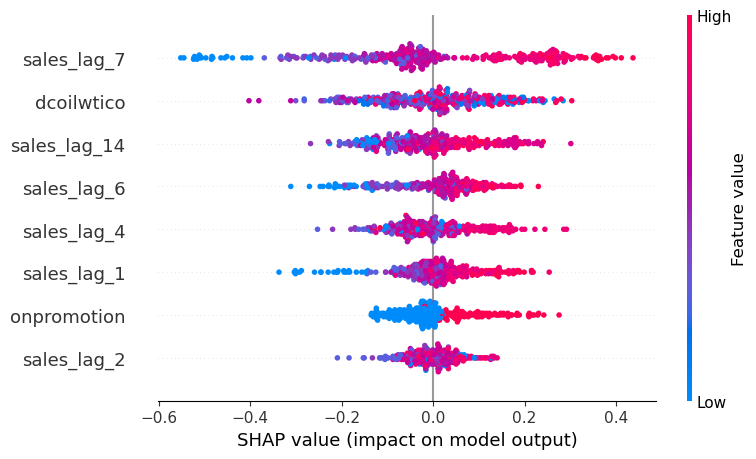

15, beauty


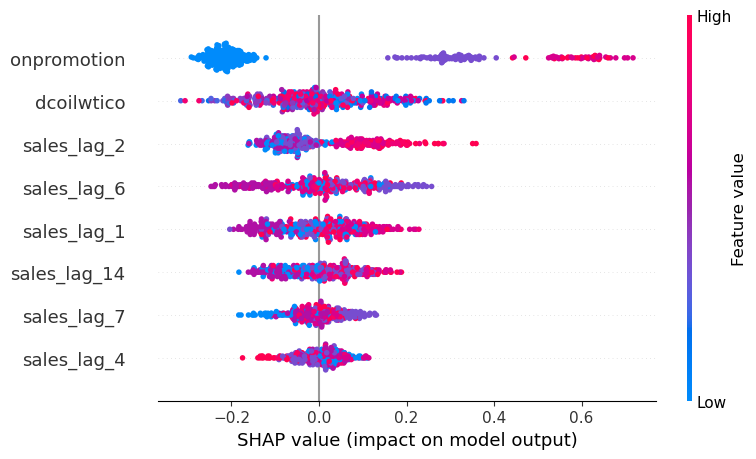

34, beauty


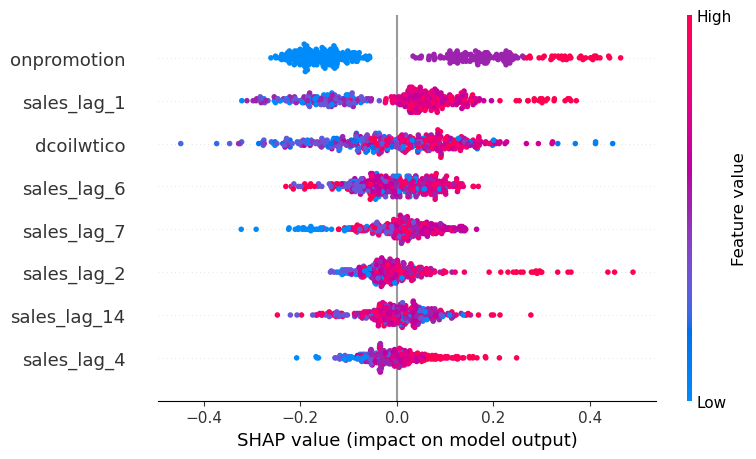

40, beauty


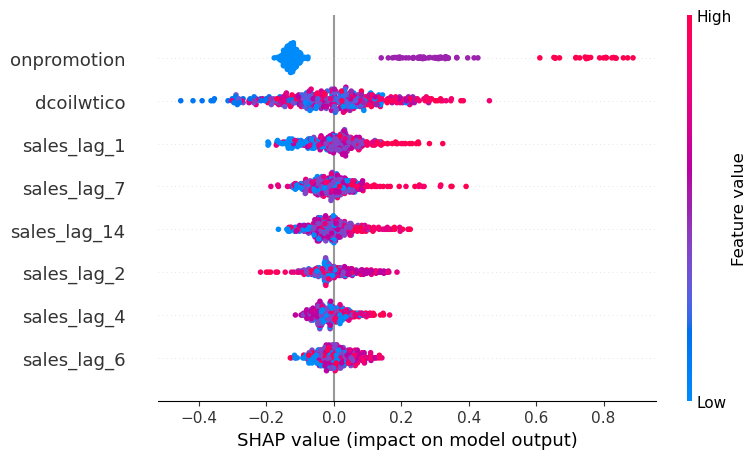

22, beauty


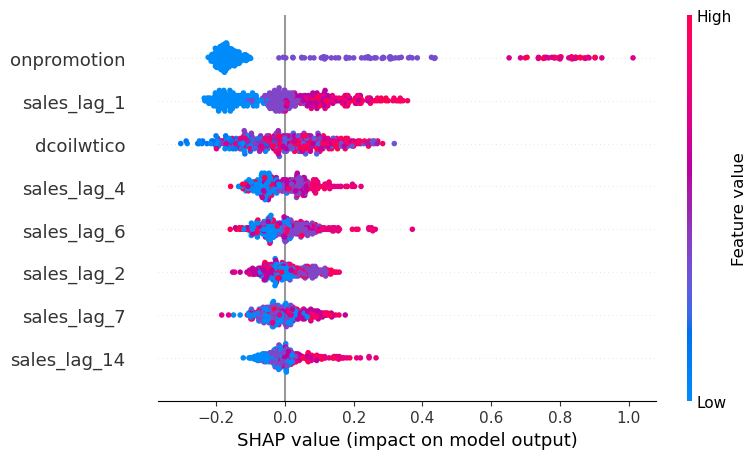

54, beverages


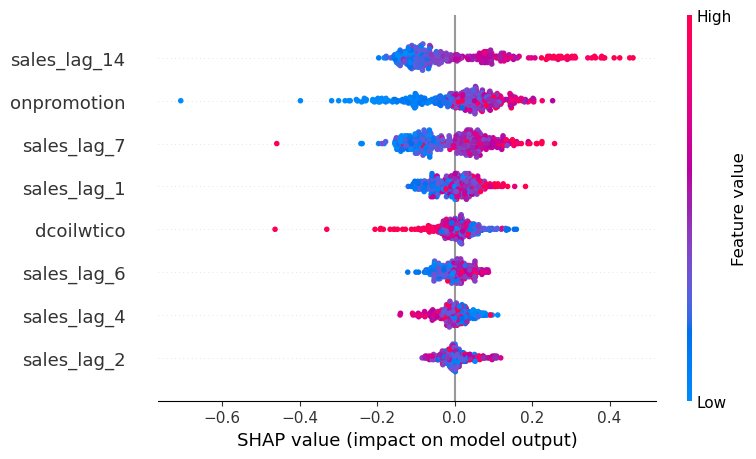

54, celebration


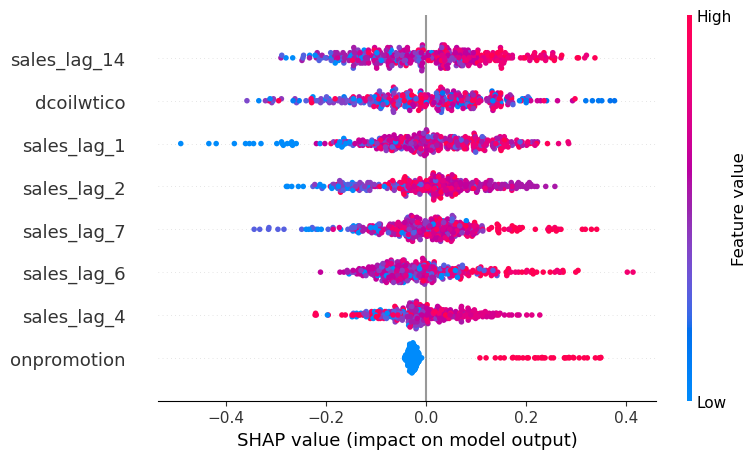

33, celebration


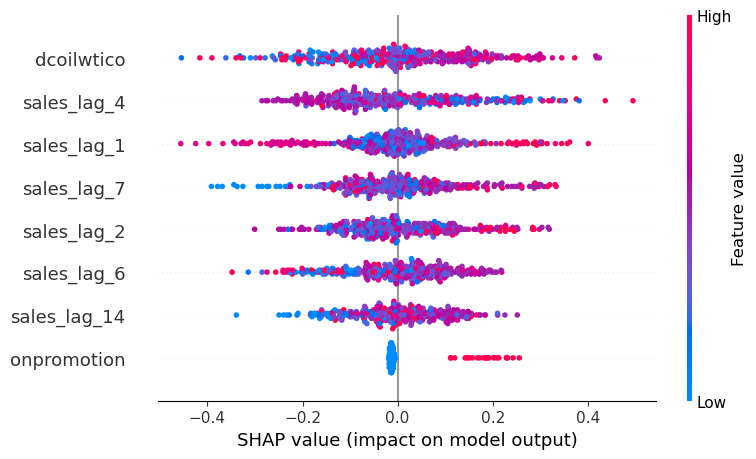

15, celebration


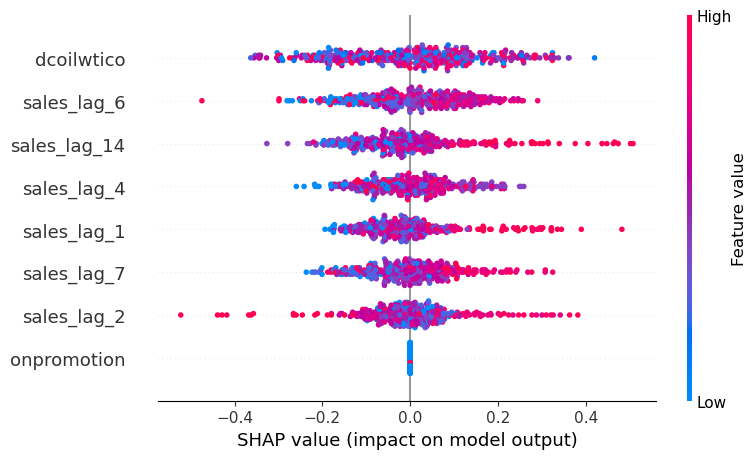

1, celebration


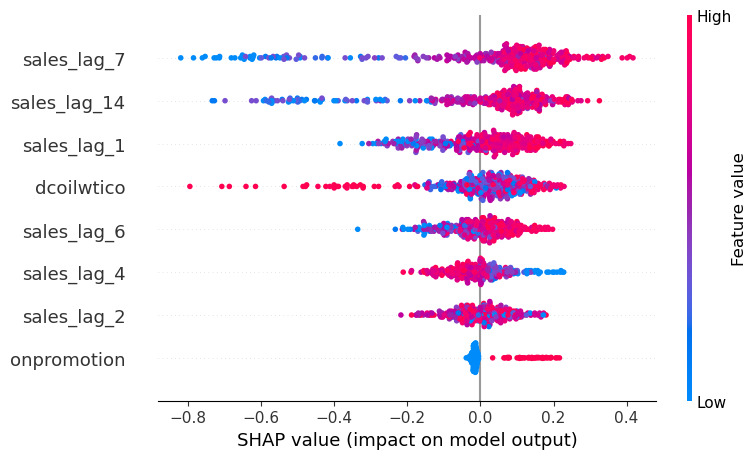

32, celebration


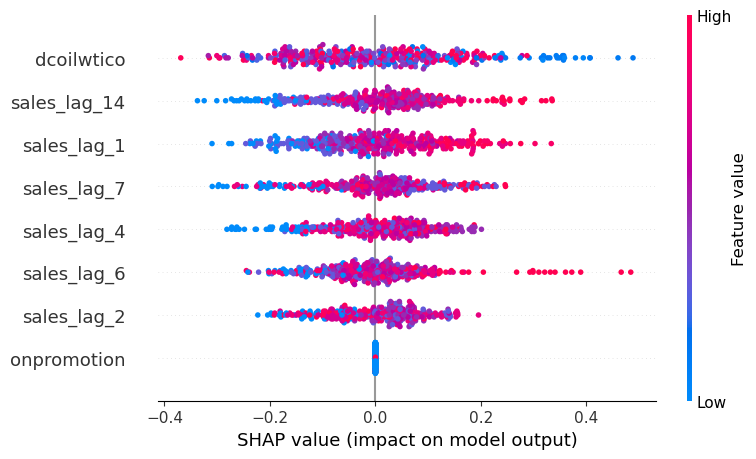

17, celebration


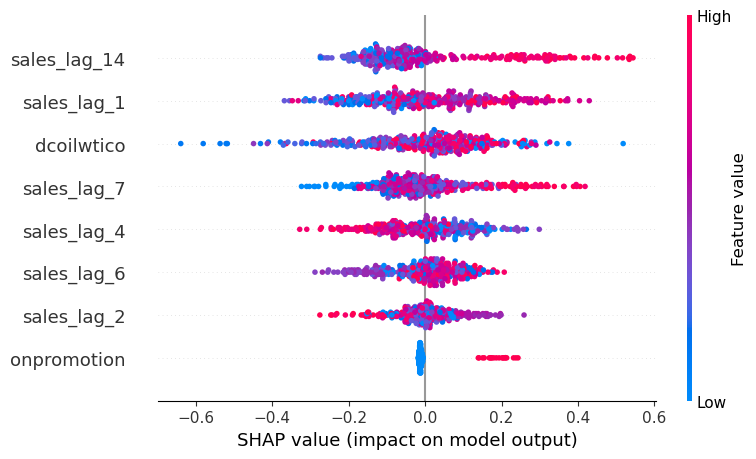

40, celebration


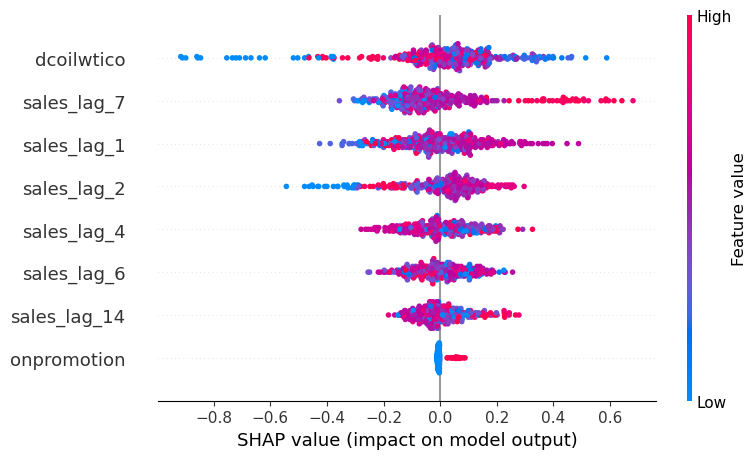

43, celebration


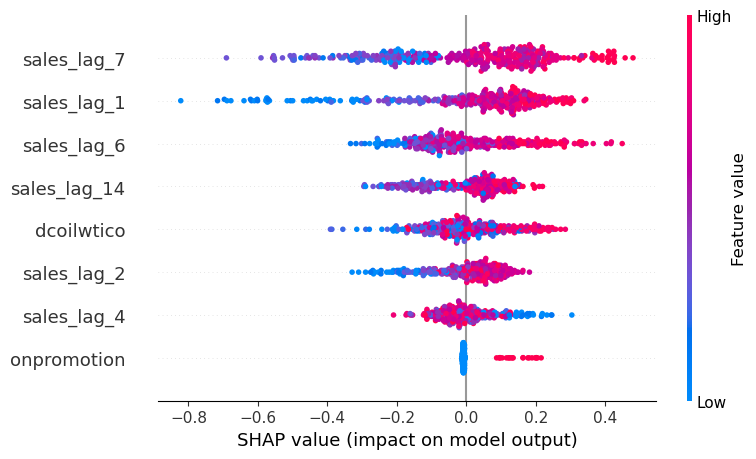

36, celebration


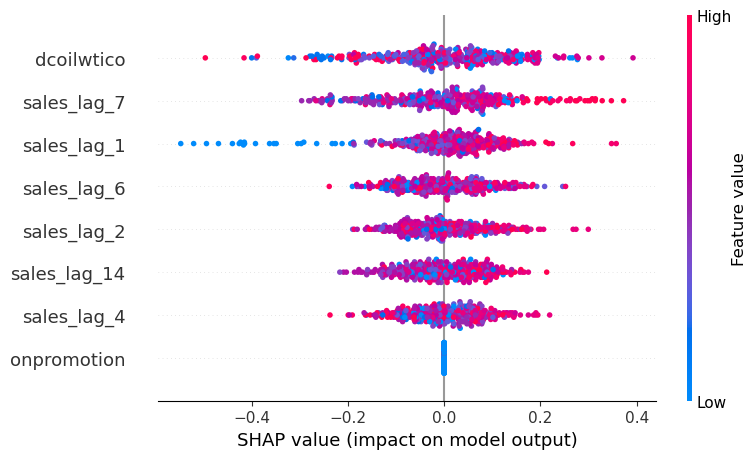

14, celebration


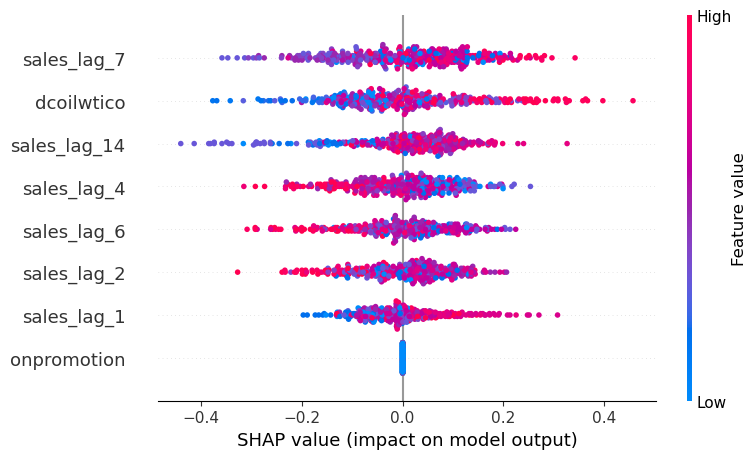

19, celebration


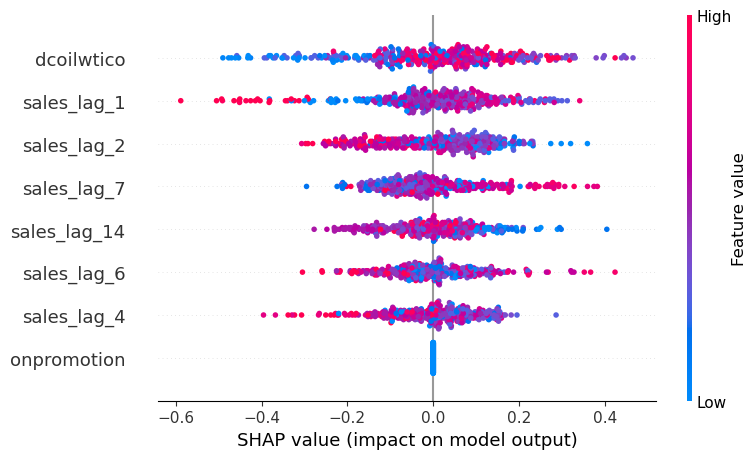

30, cleaning


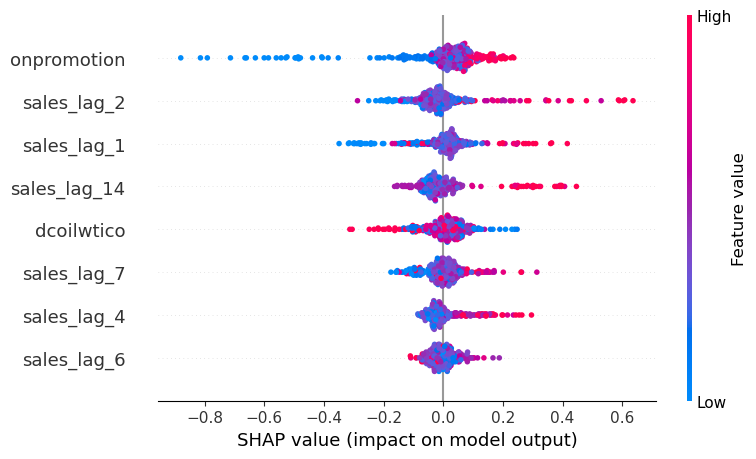

32, cleaning


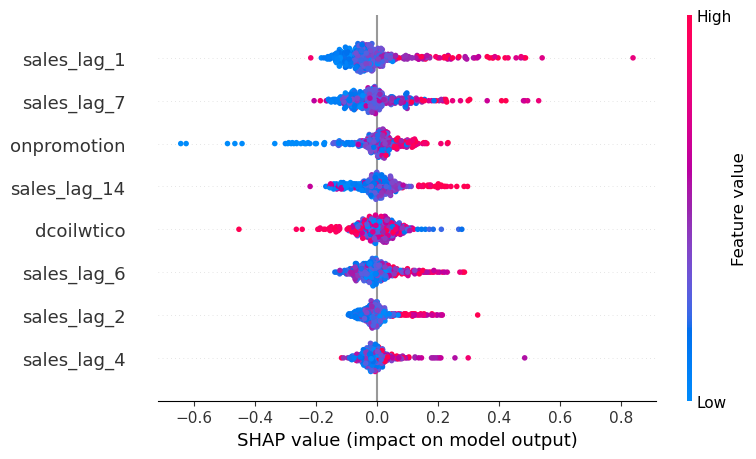

10, eggs


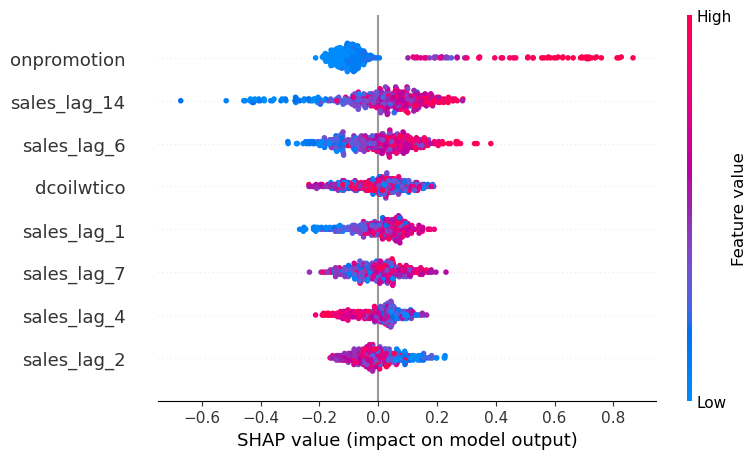

34, hardware


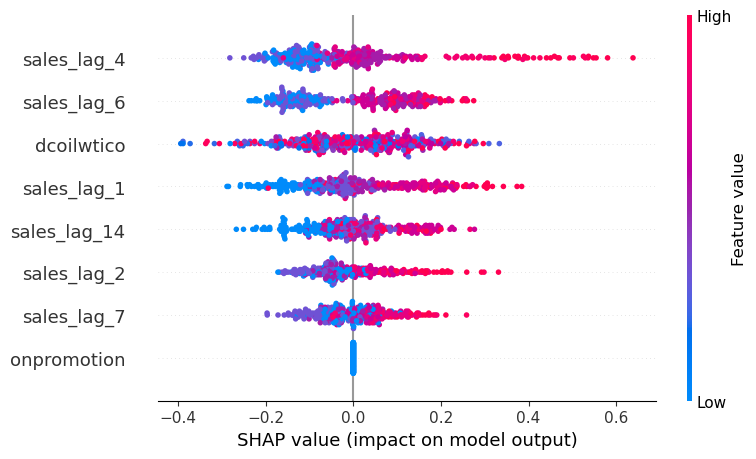

8, hardware


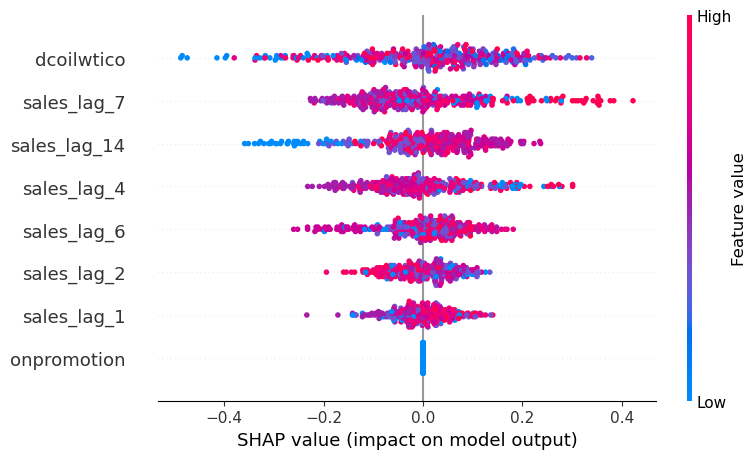

1, home and kitchen i


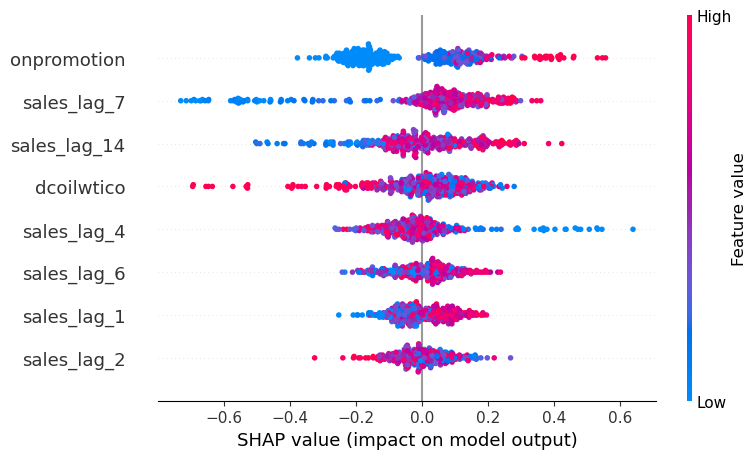

22, home and kitchen i


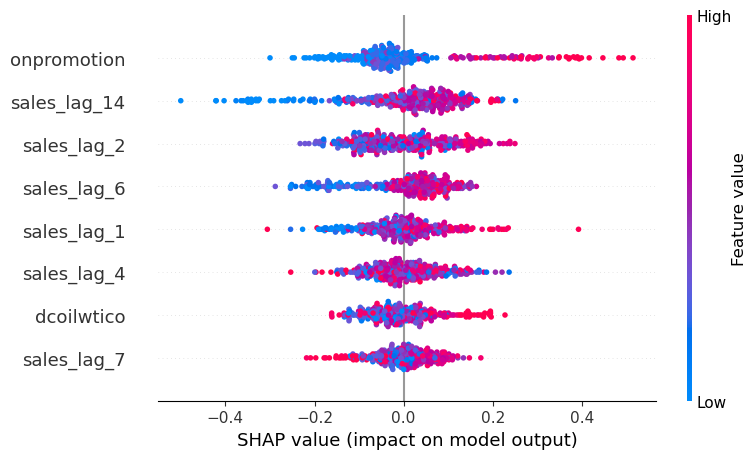

10, home and kitchen i


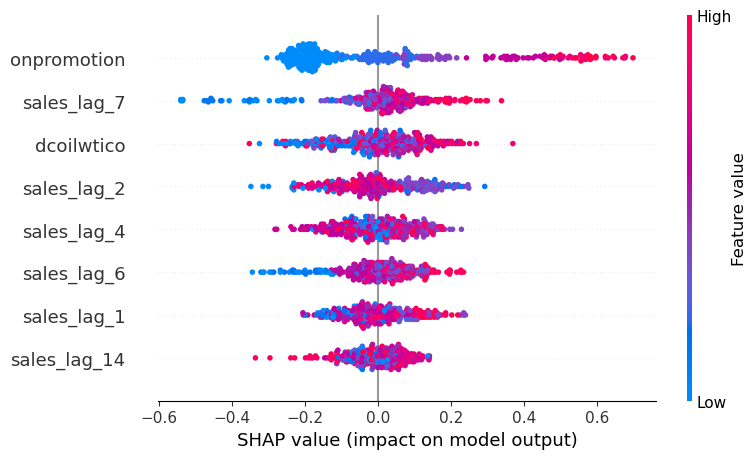

38, home and kitchen ii


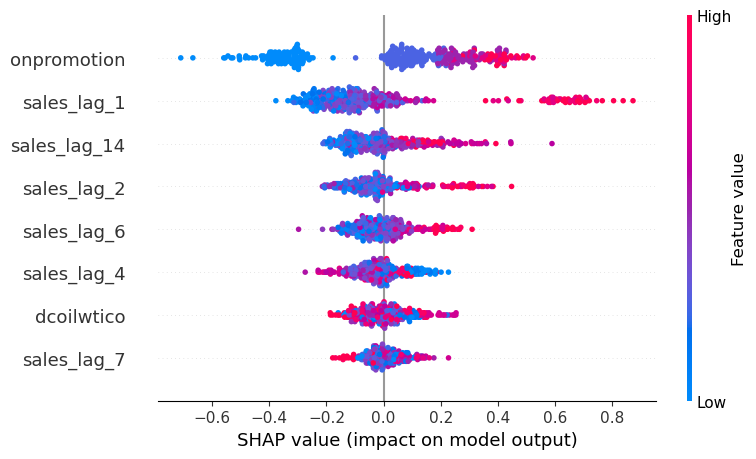

48, home and kitchen ii


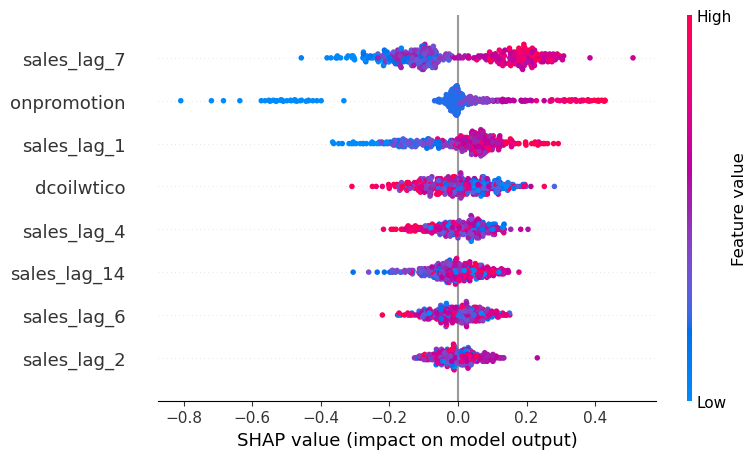

46, home and kitchen ii


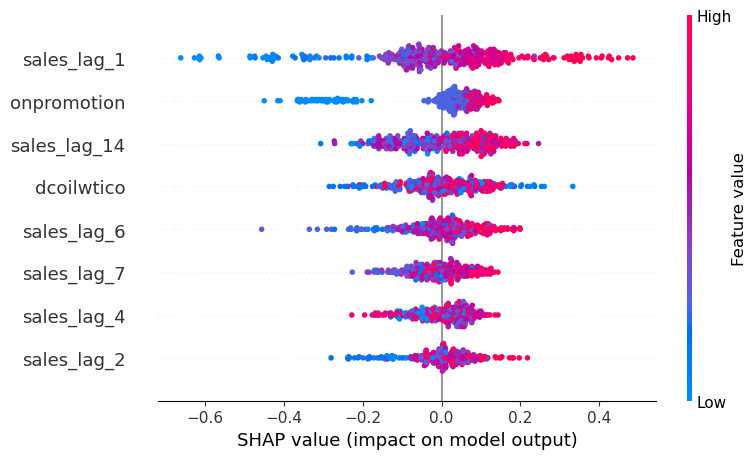

12, ladieswear


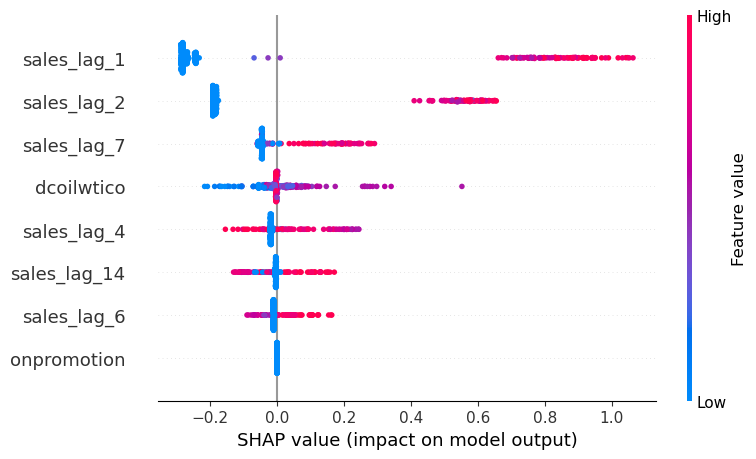

20, ladieswear


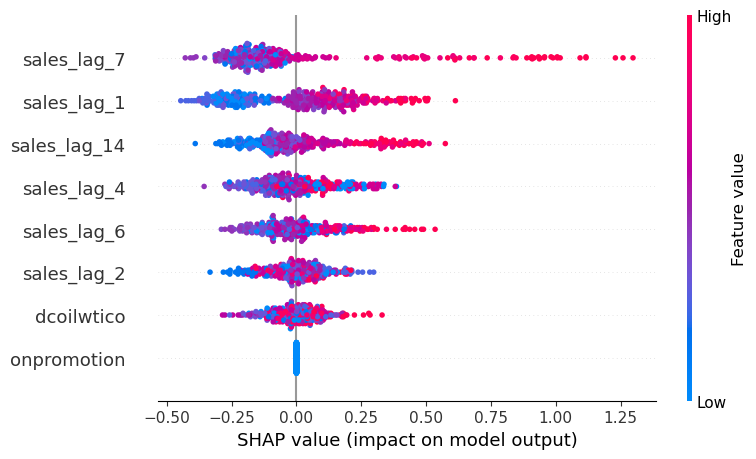

34, ladieswear


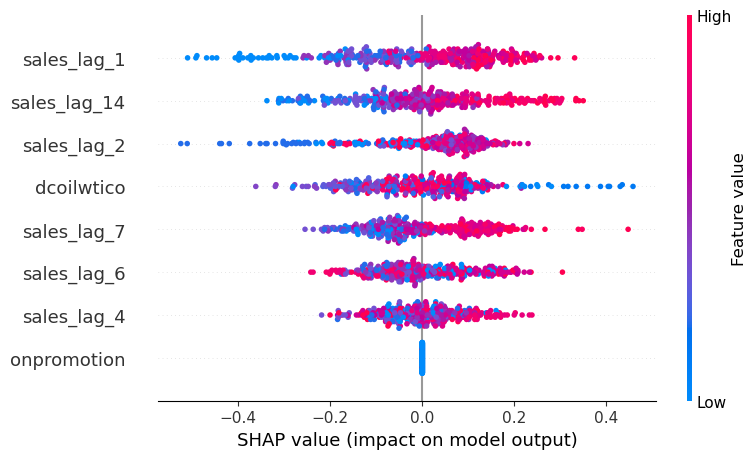

51, ladieswear


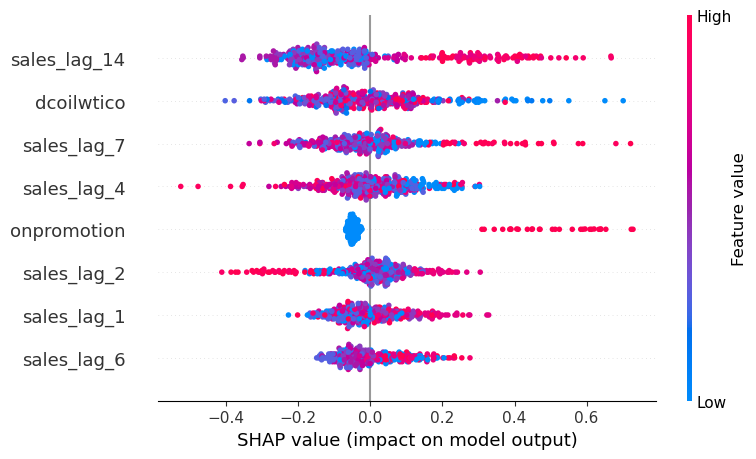

53, ladieswear


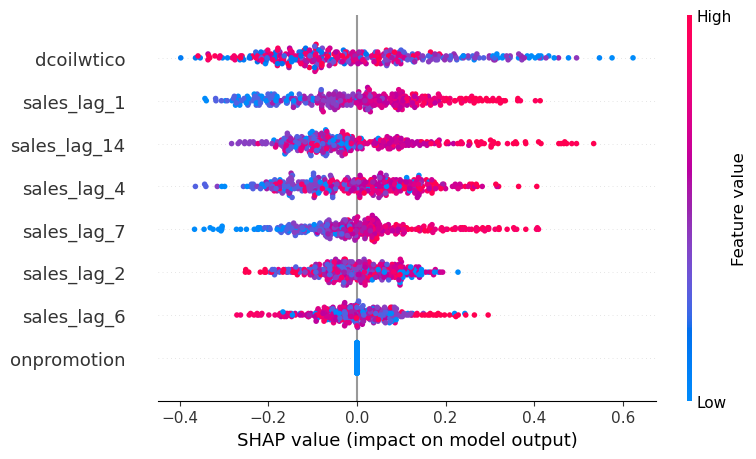

17, ladieswear


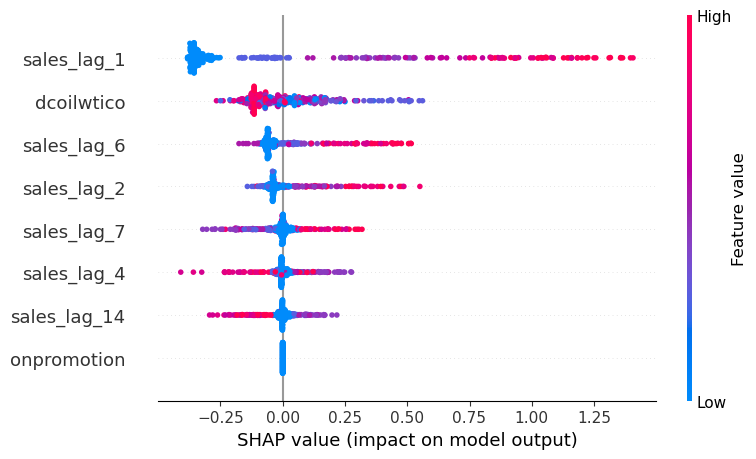

22, ladieswear


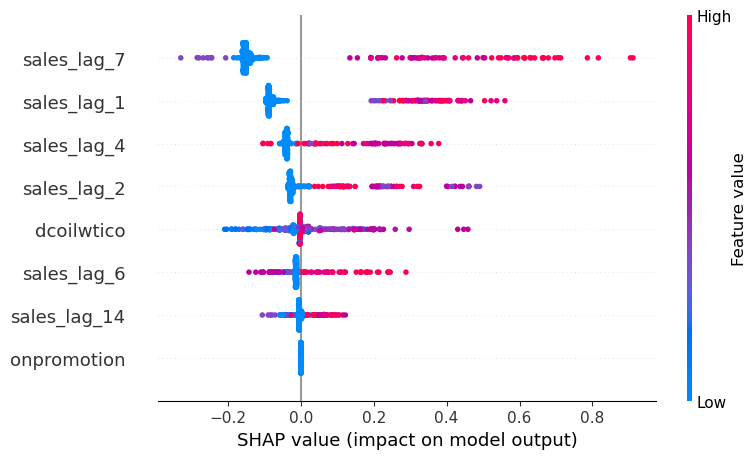

10, ladieswear


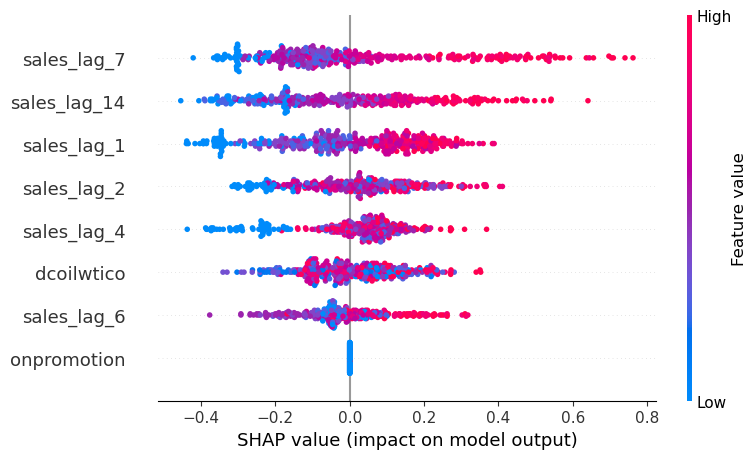

13, ladieswear


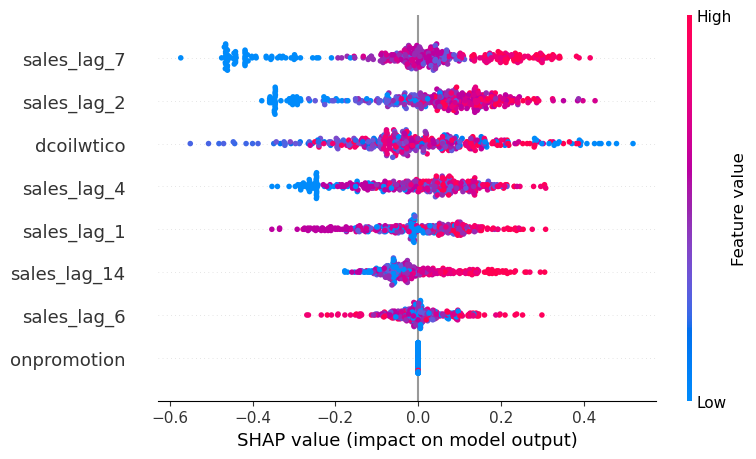

27, ladieswear


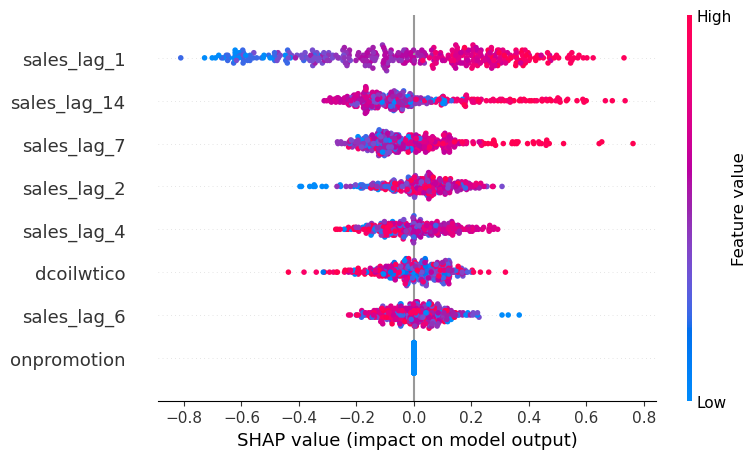

14, ladieswear


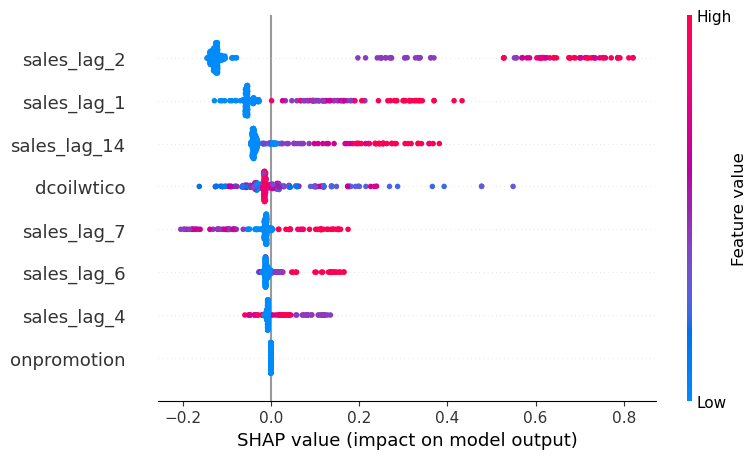

50, ladieswear


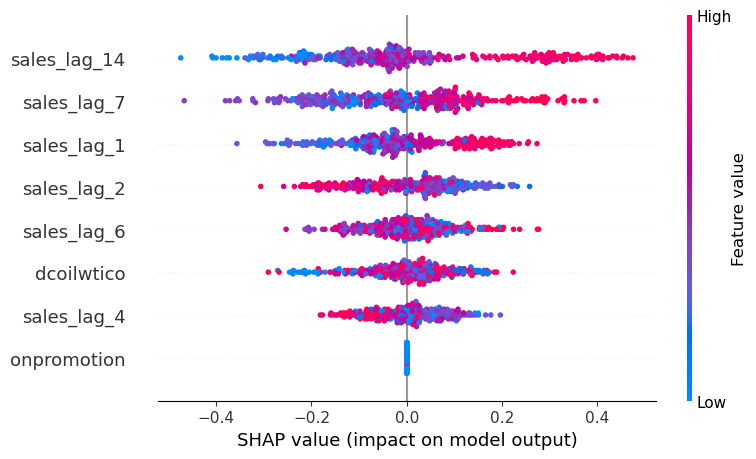

39, ladieswear


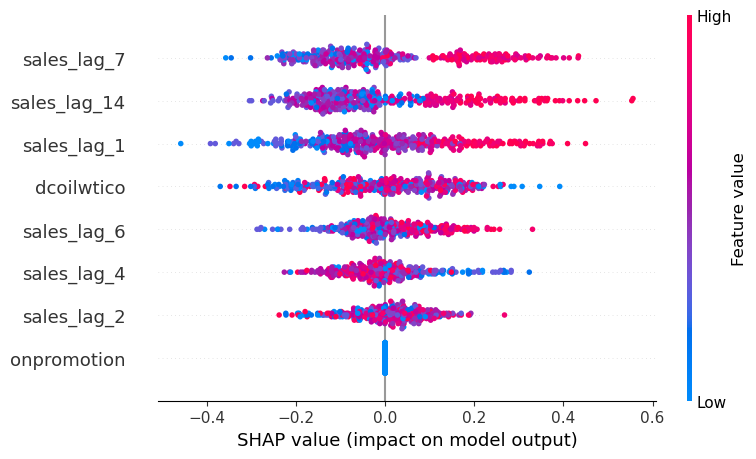

11, ladieswear


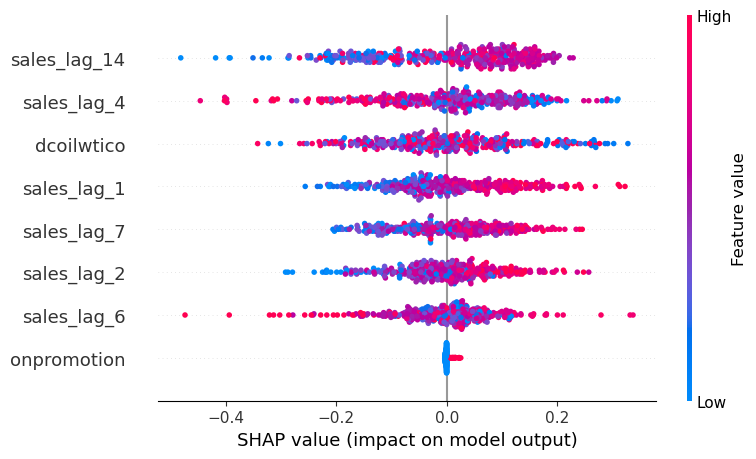

19, ladieswear


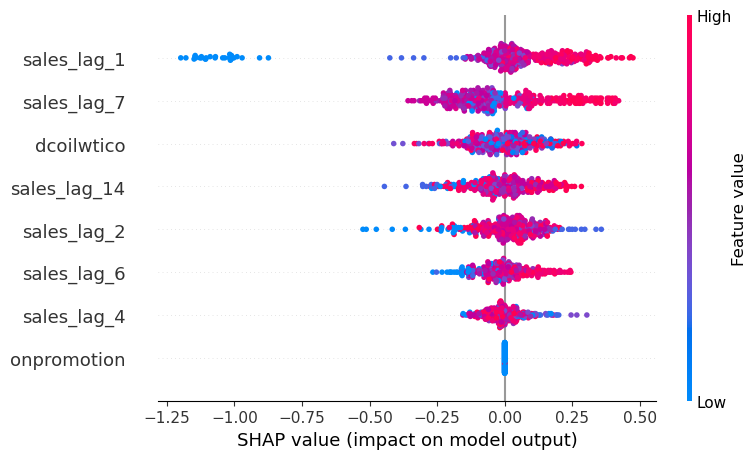

31, lawn and garden


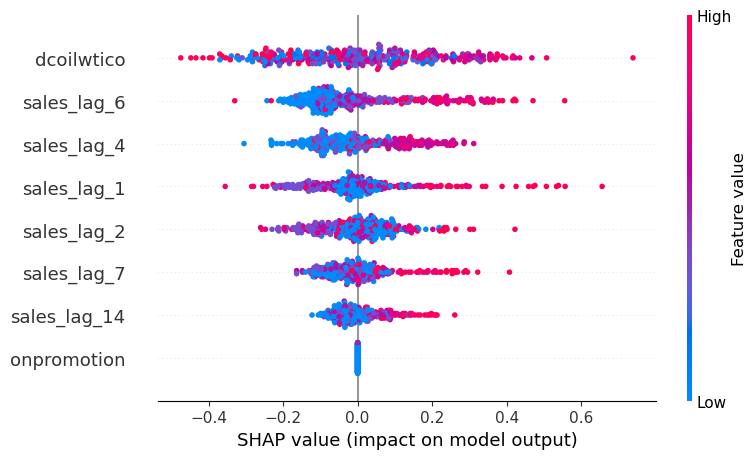

28, lawn and garden


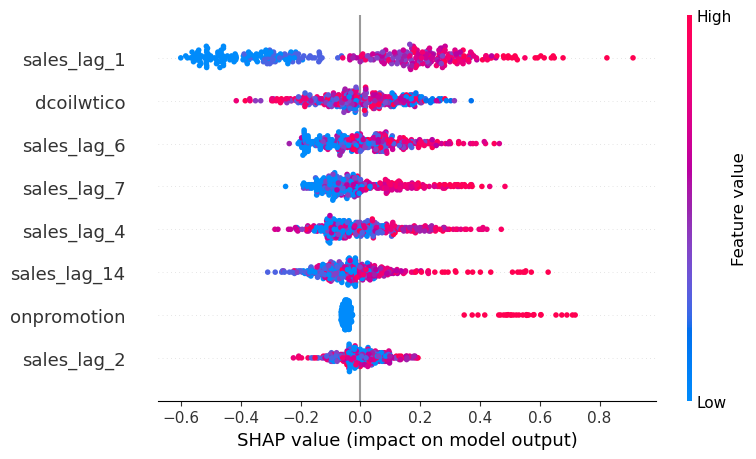

43, lawn and garden


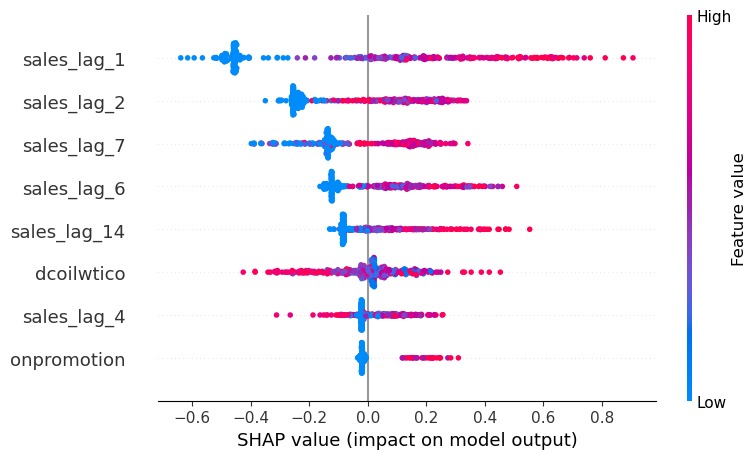

26, lawn and garden


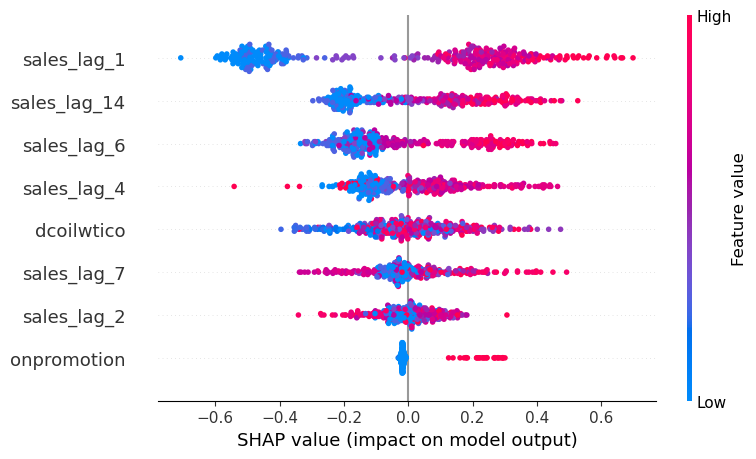

34, lawn and garden


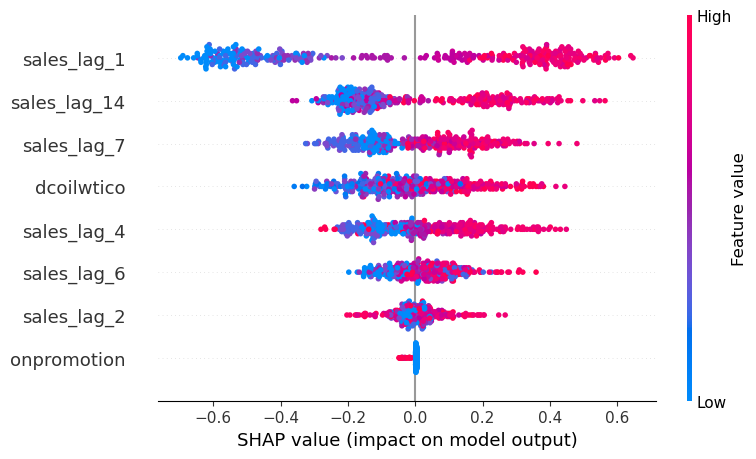

11, lawn and garden


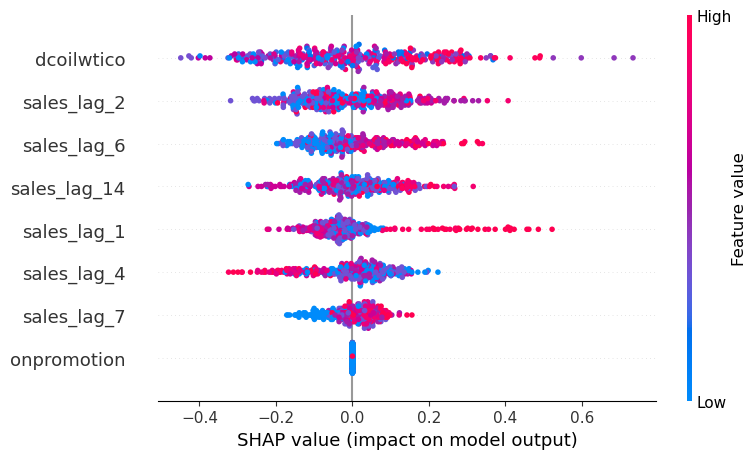

23, lawn and garden


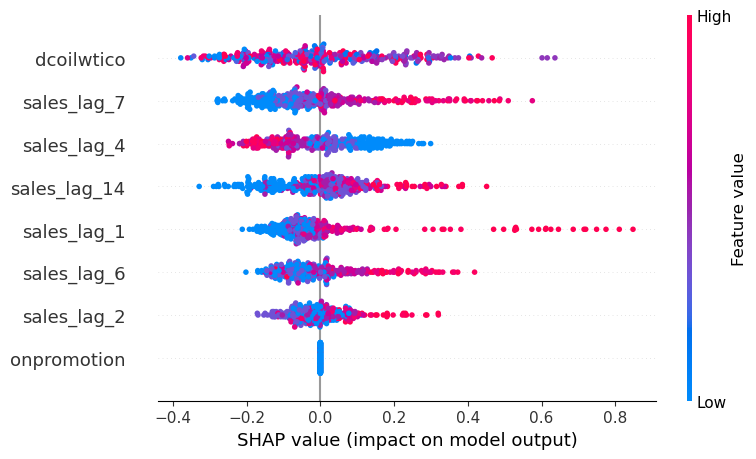

36, lawn and garden


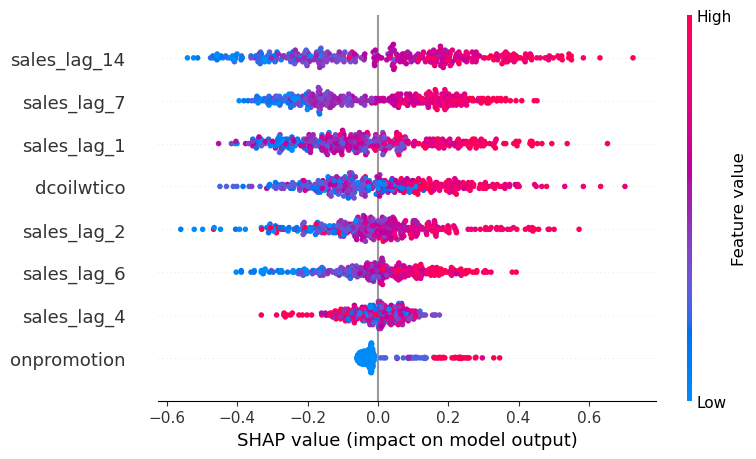

20, lawn and garden


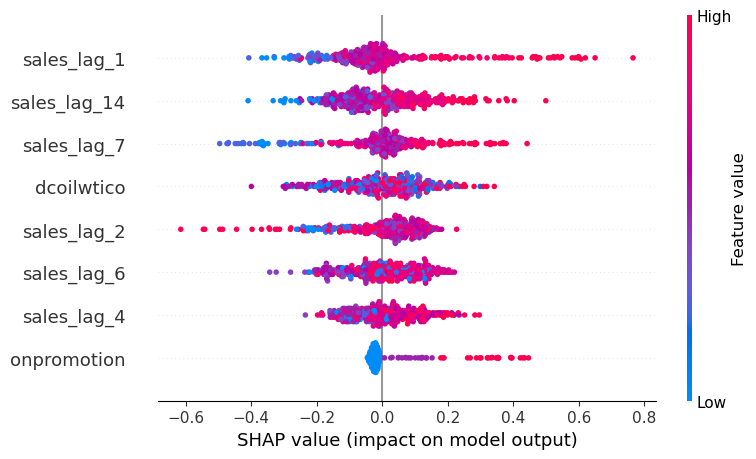

50, lingerie


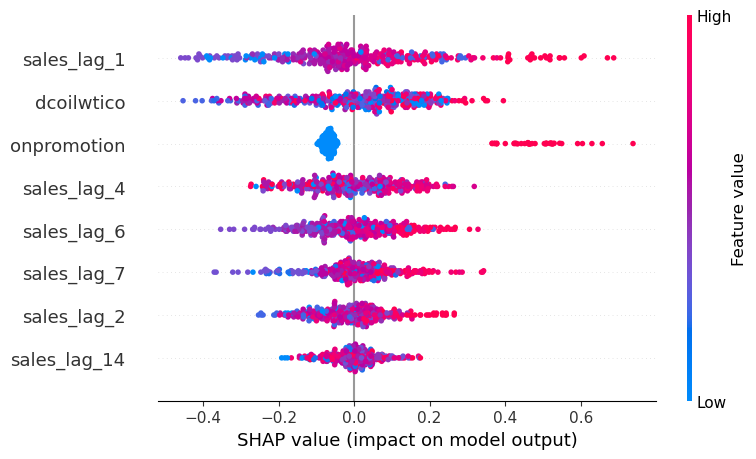

1, lingerie


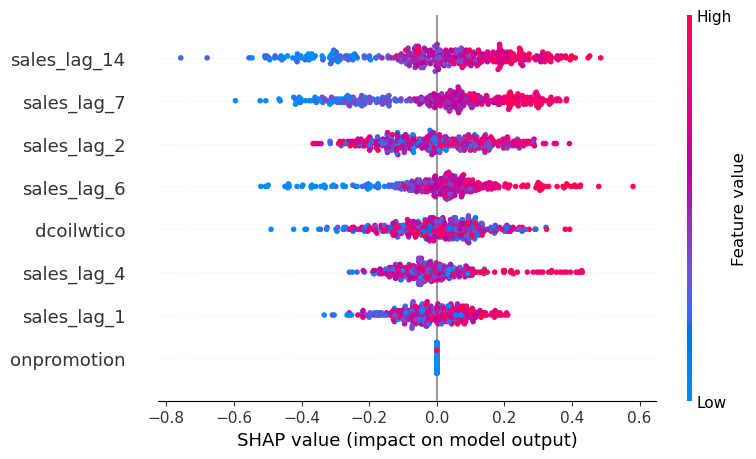

44, lingerie


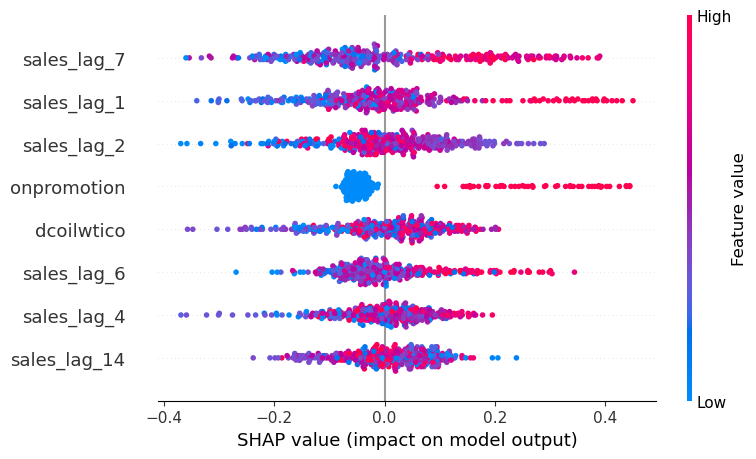

47, lingerie


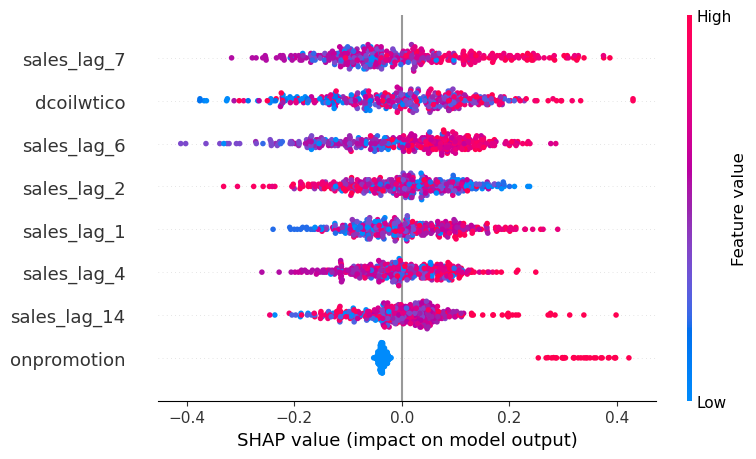

48, lingerie


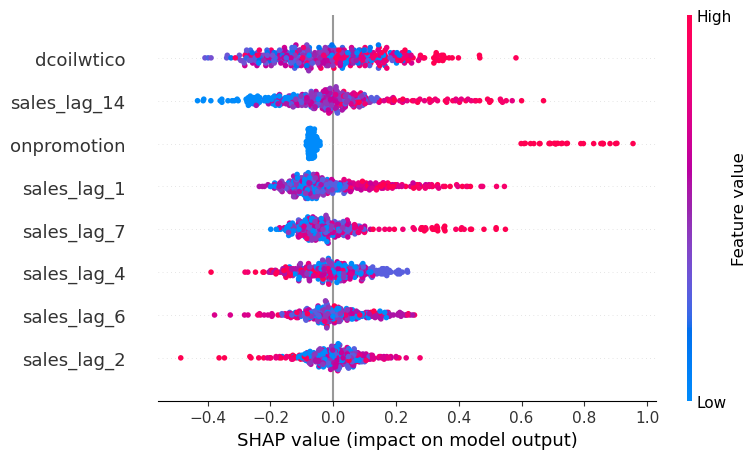

45, lingerie


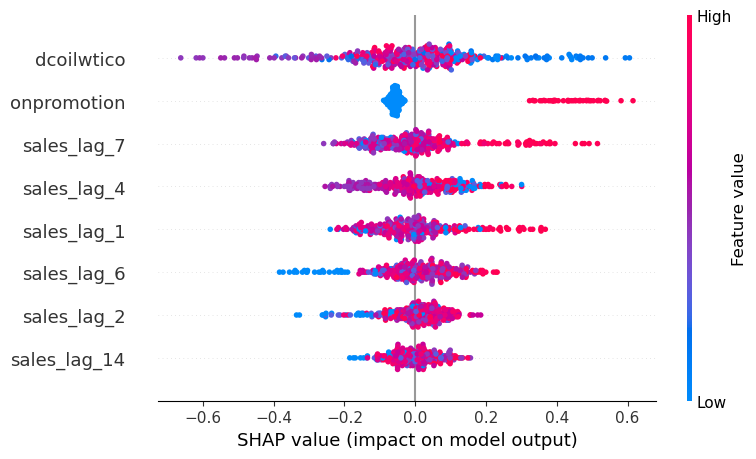

36, lingerie


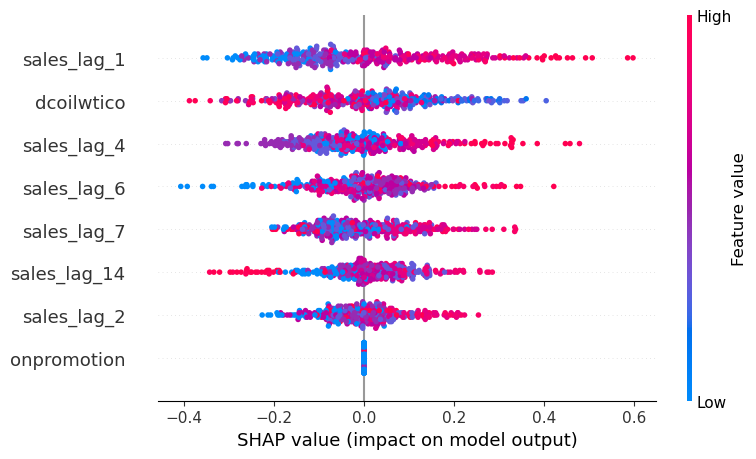

23, lingerie


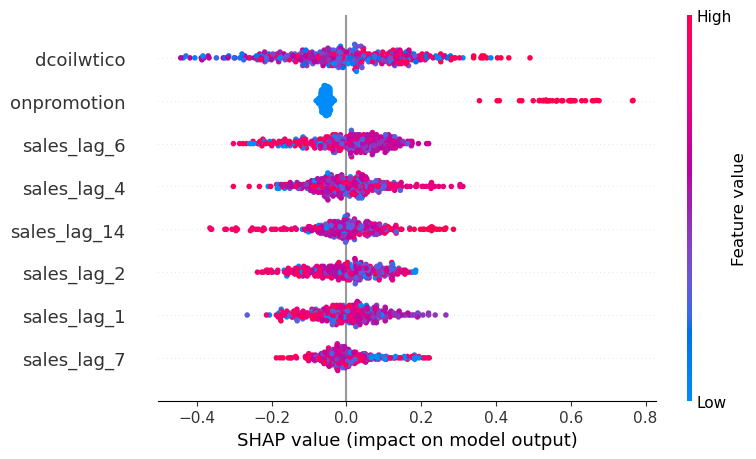

26, lingerie


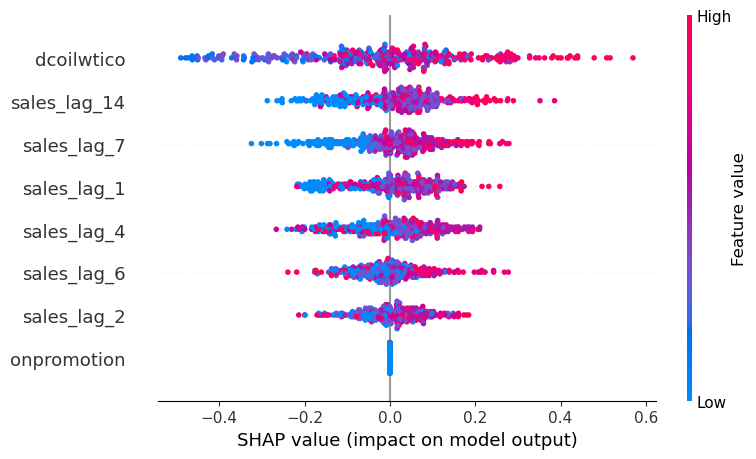

17, lingerie


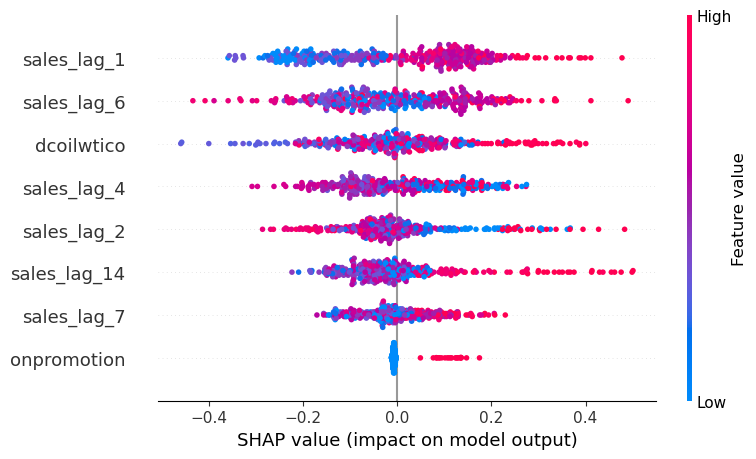

13, lingerie


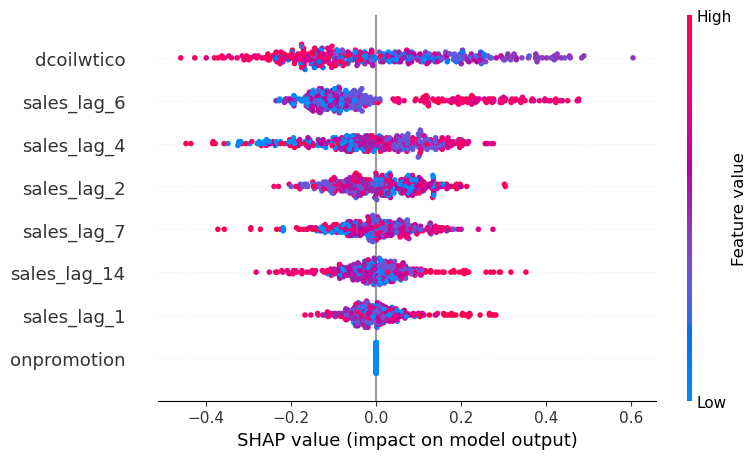

29, lingerie


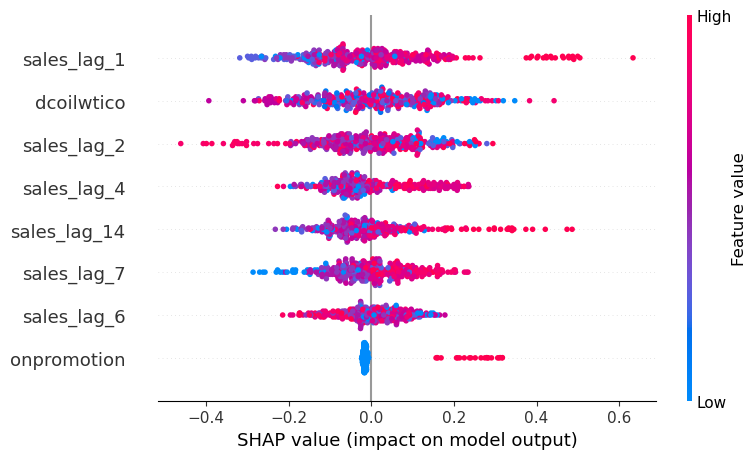

37, lingerie


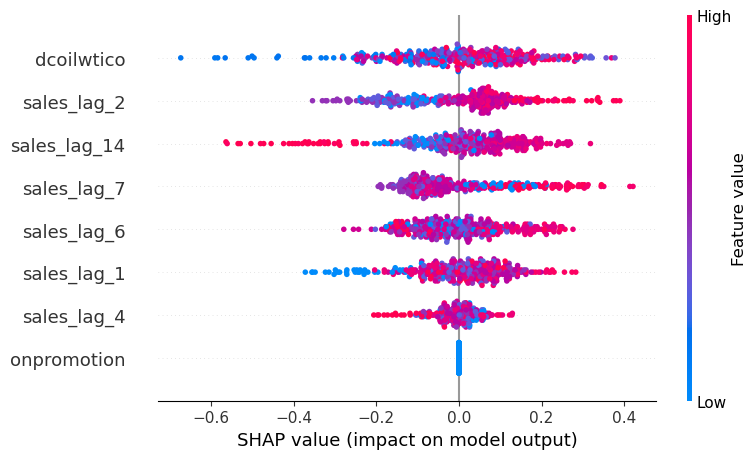

12, lingerie


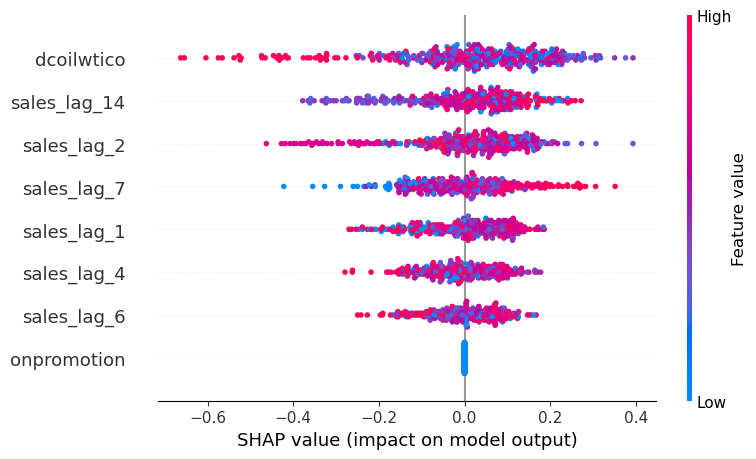

39, lingerie


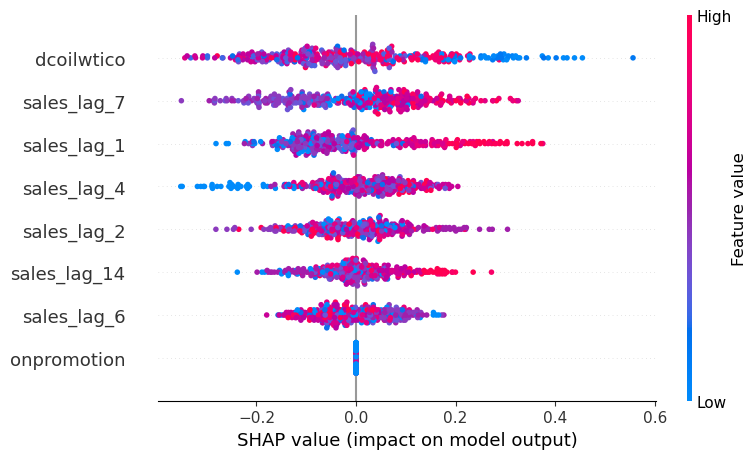

7, lingerie


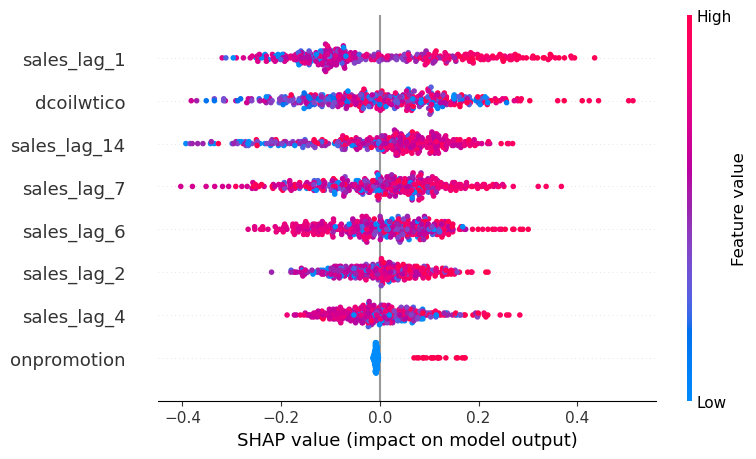

22, lingerie


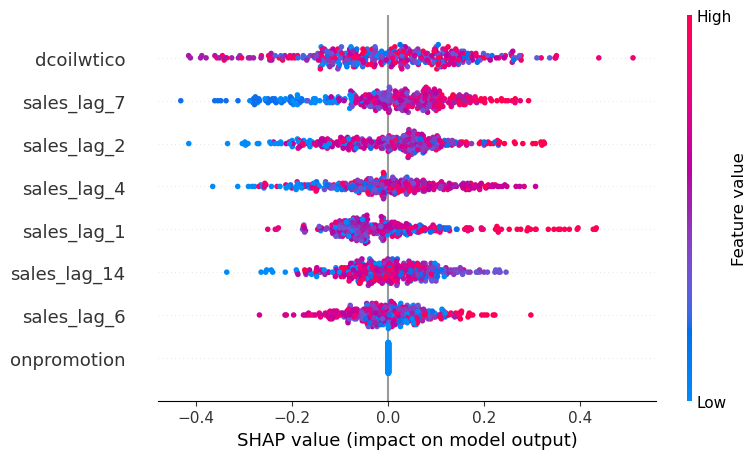

19, lingerie


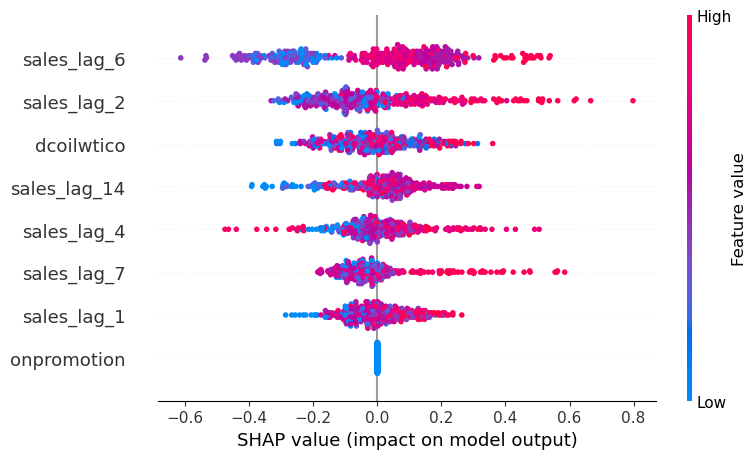

34, lingerie


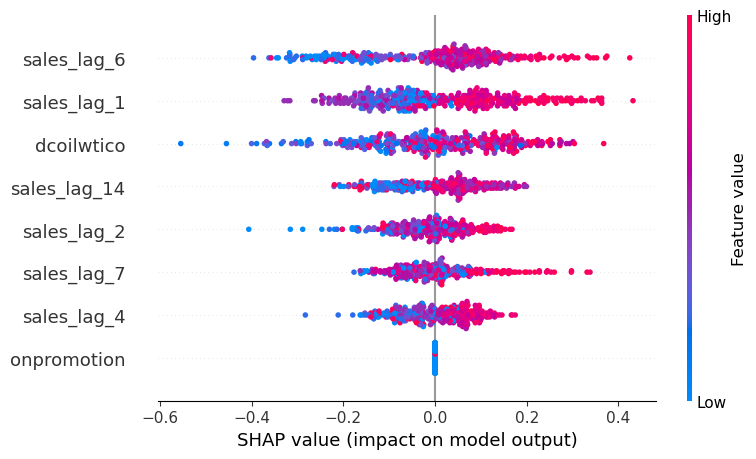

20, lingerie


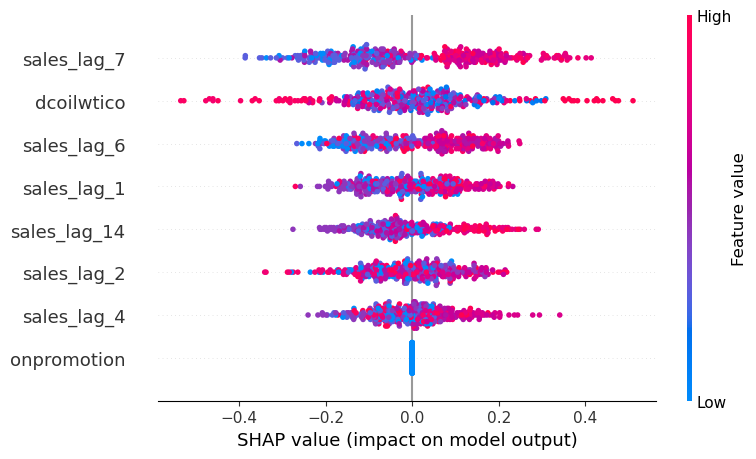

32, liquor,wine,beer


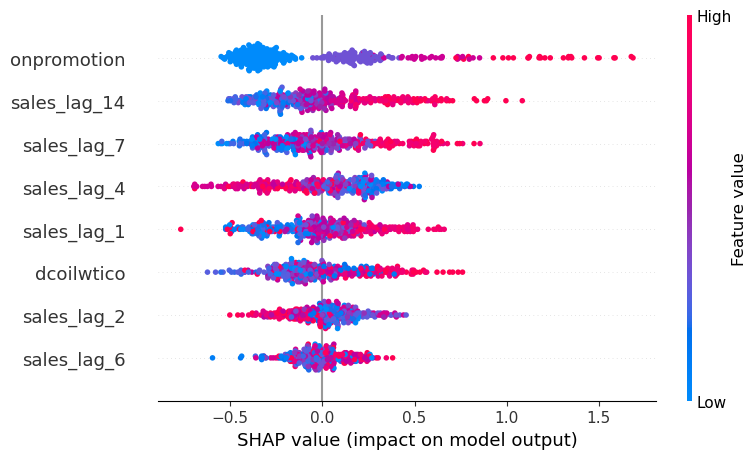

22, liquor,wine,beer


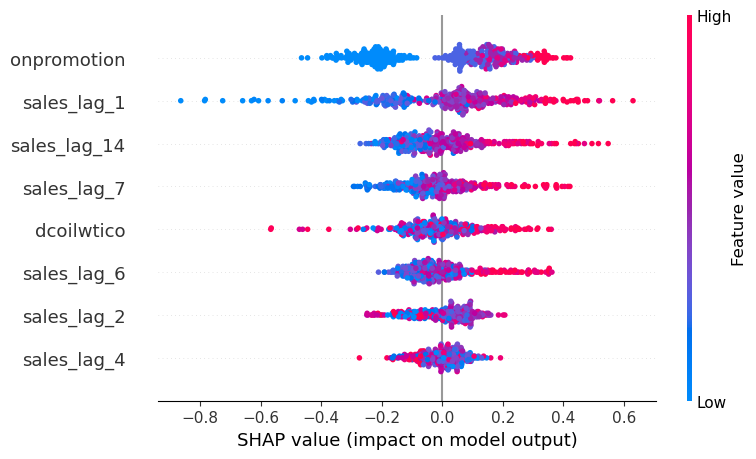

33, liquor,wine,beer


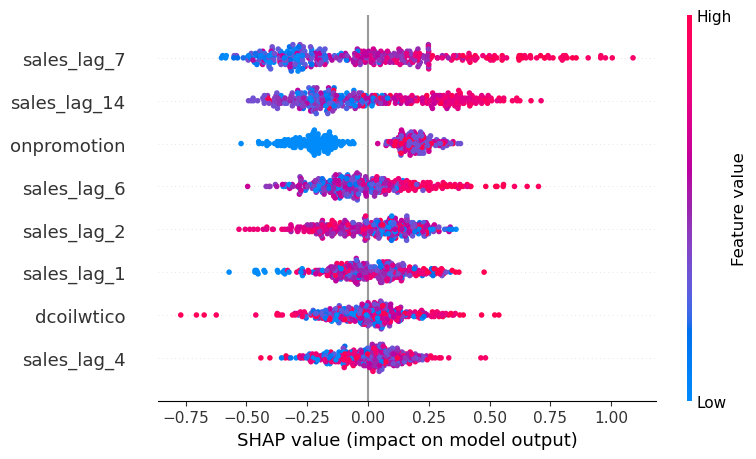

40, liquor,wine,beer


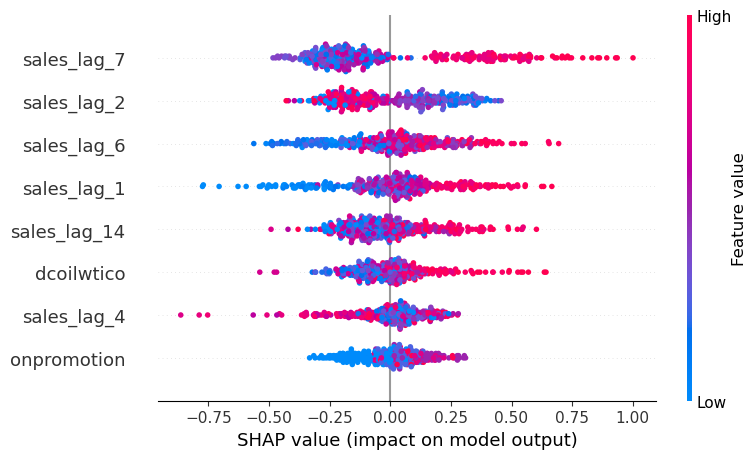

30, liquor,wine,beer


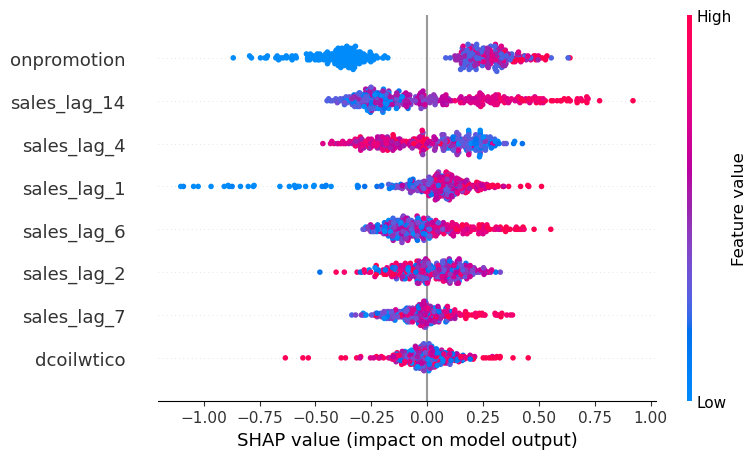

54, liquor,wine,beer


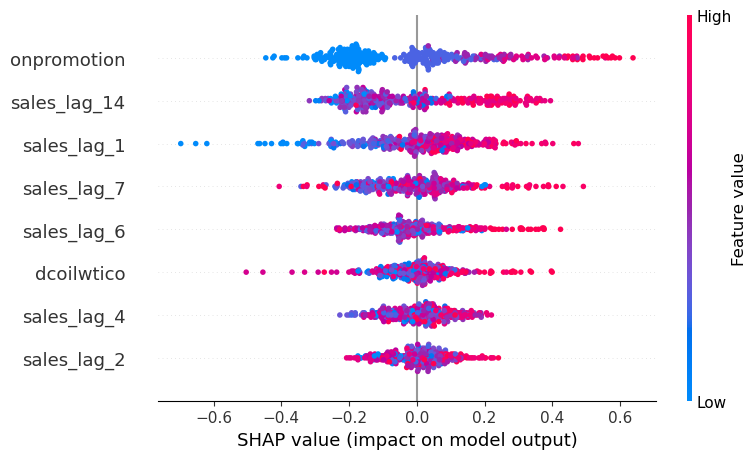

19, liquor,wine,beer


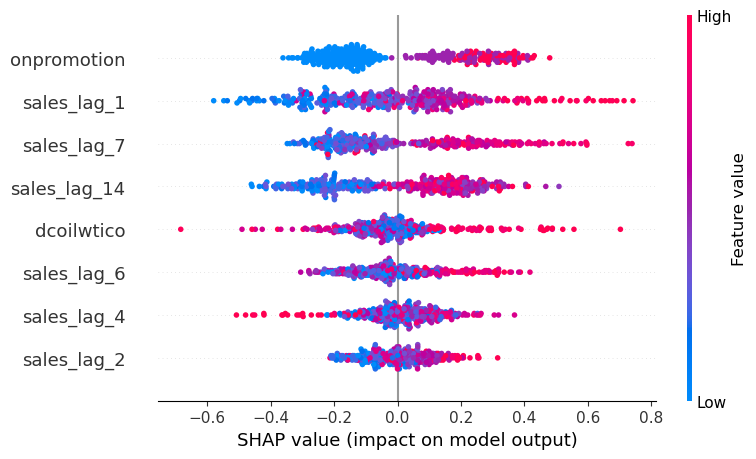

41, liquor,wine,beer


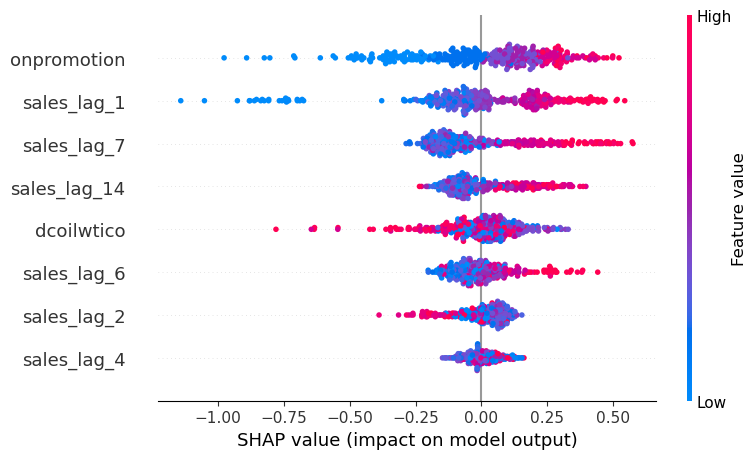

28, liquor,wine,beer


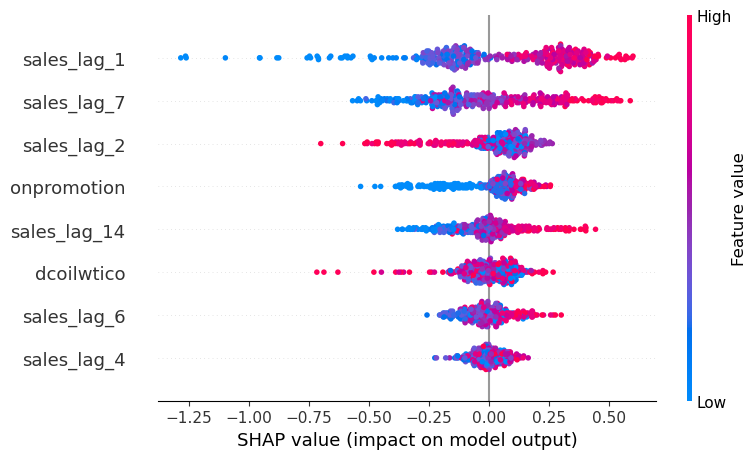

43, liquor,wine,beer


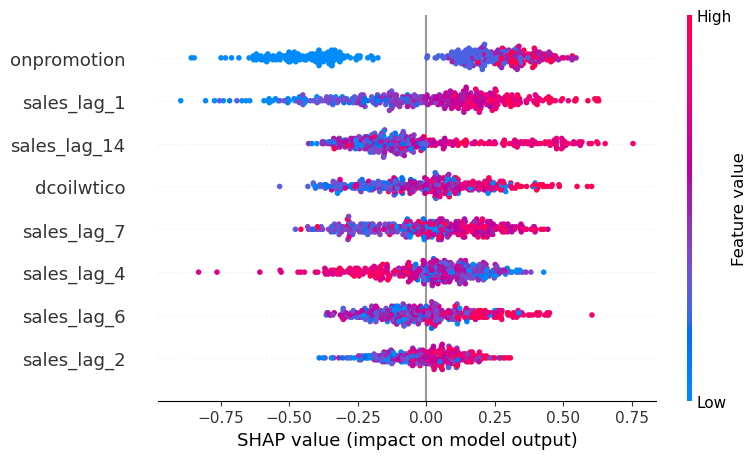

38, liquor,wine,beer


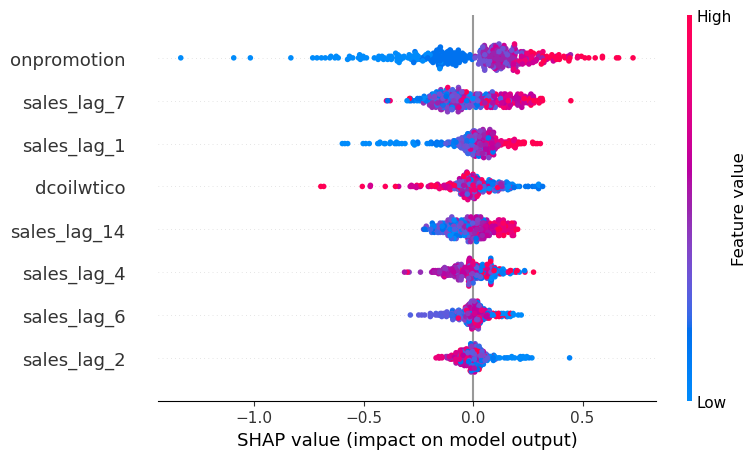

26, liquor,wine,beer


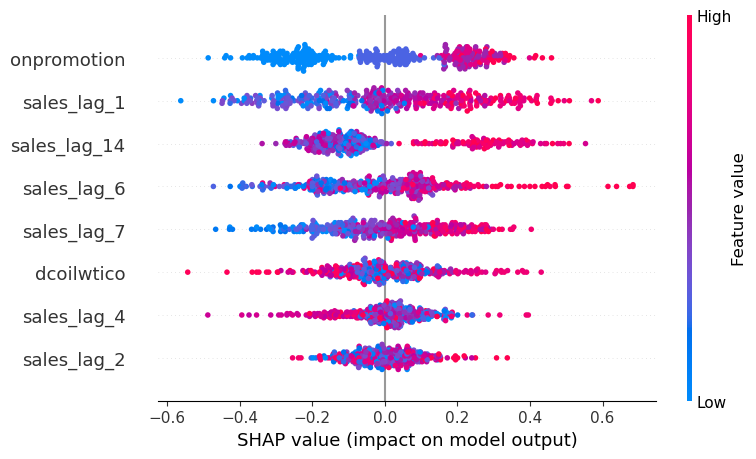

39, magazines


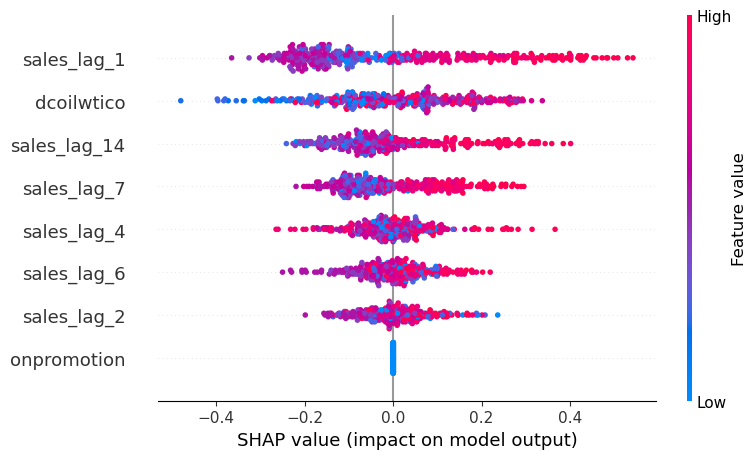

43, magazines


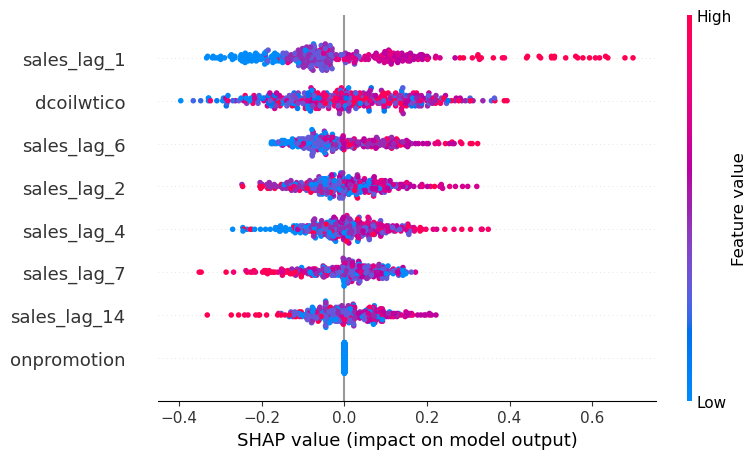

34, pet supplies


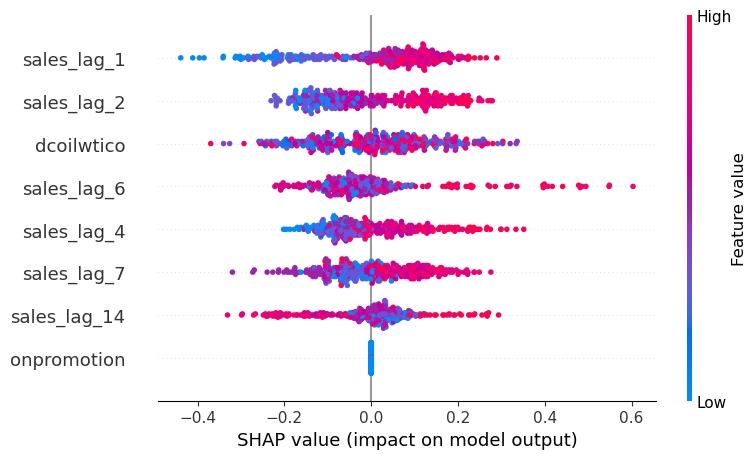

43, players and electronics


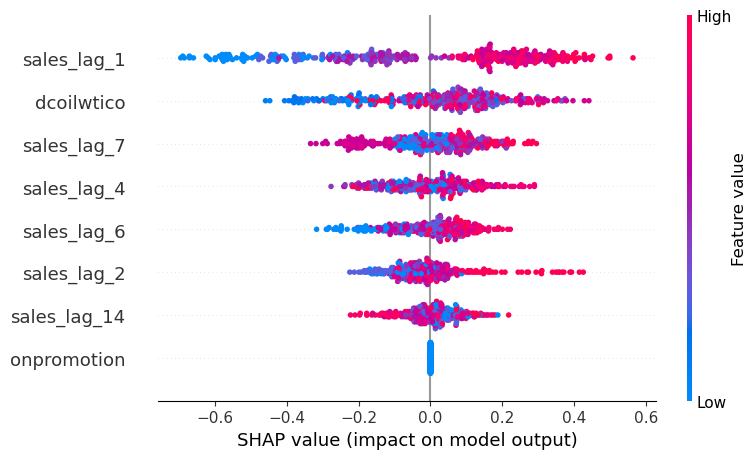

20, players and electronics


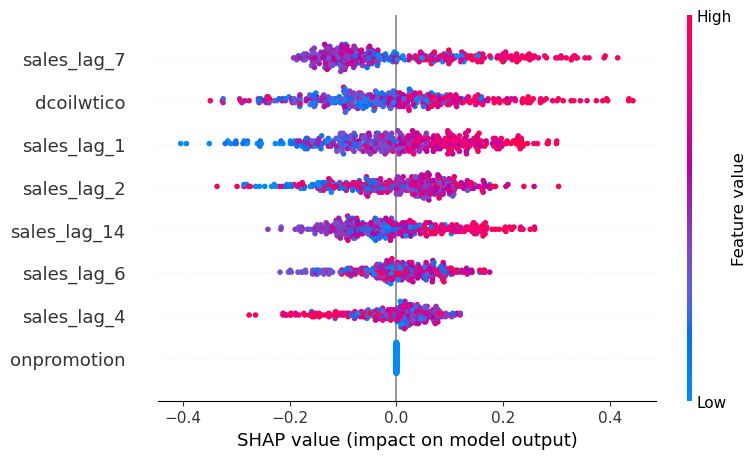

28, players and electronics


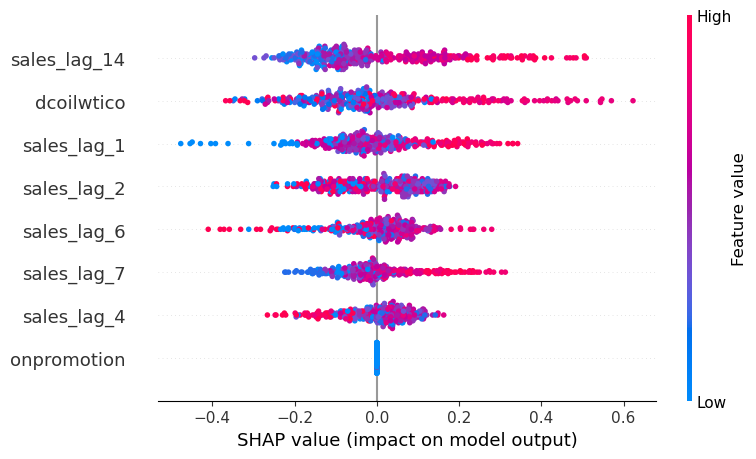

29, players and electronics


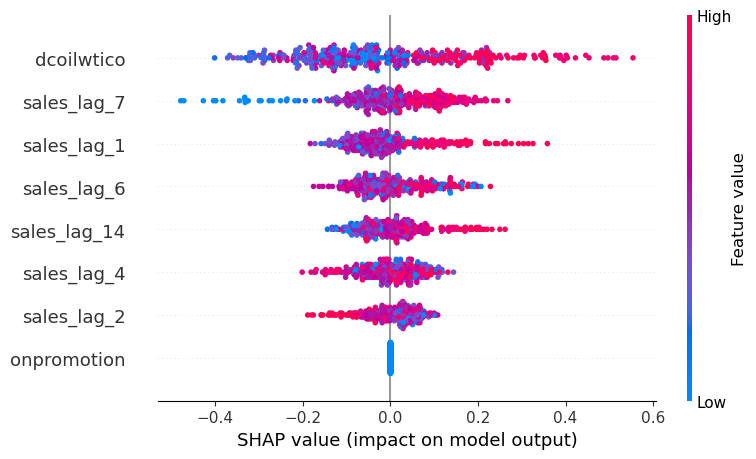

43, prepared foods


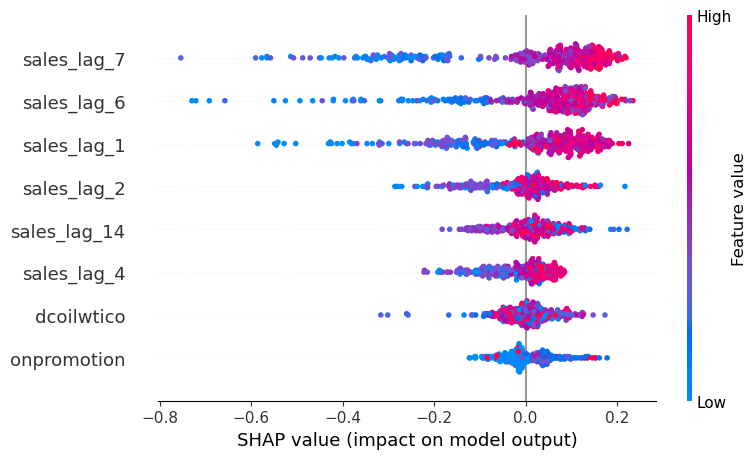

54, seafood


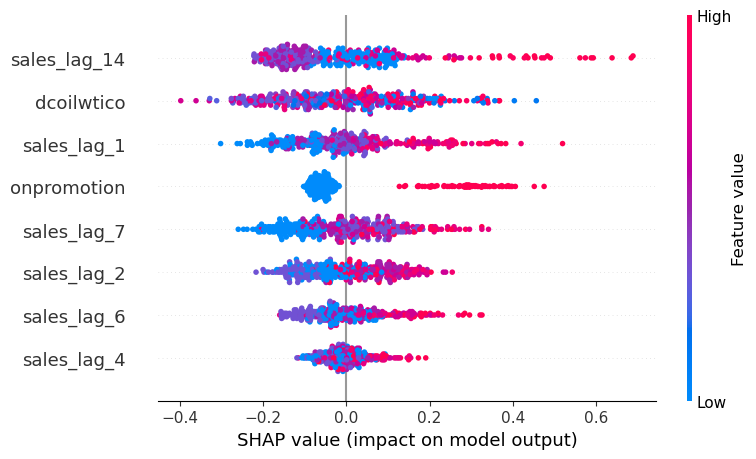

12, seafood


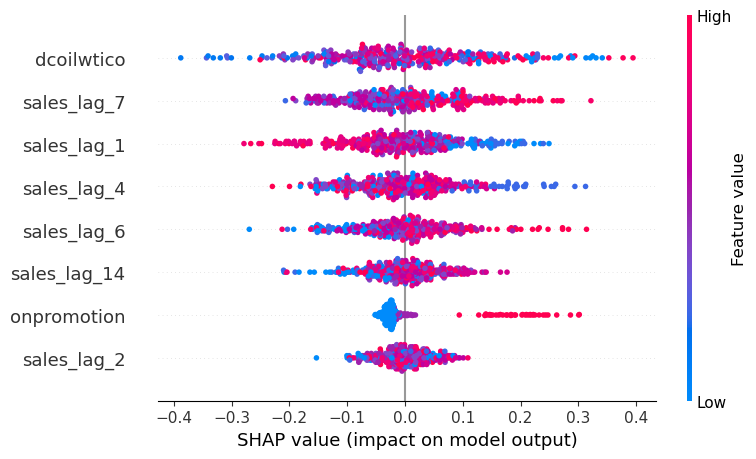

40, seafood


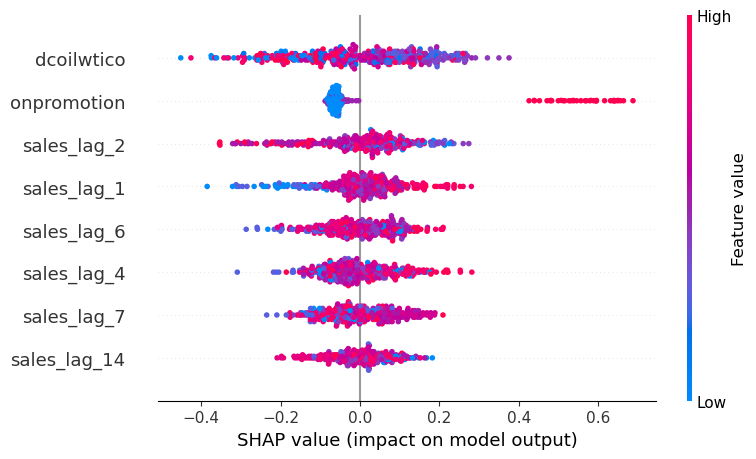

28, seafood


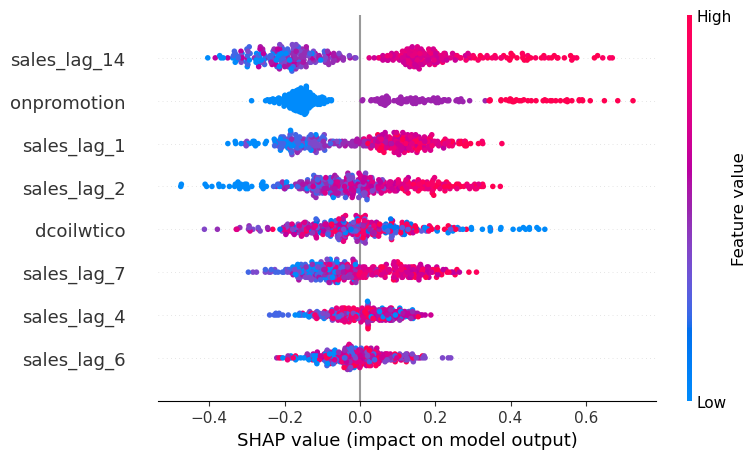

22, seafood


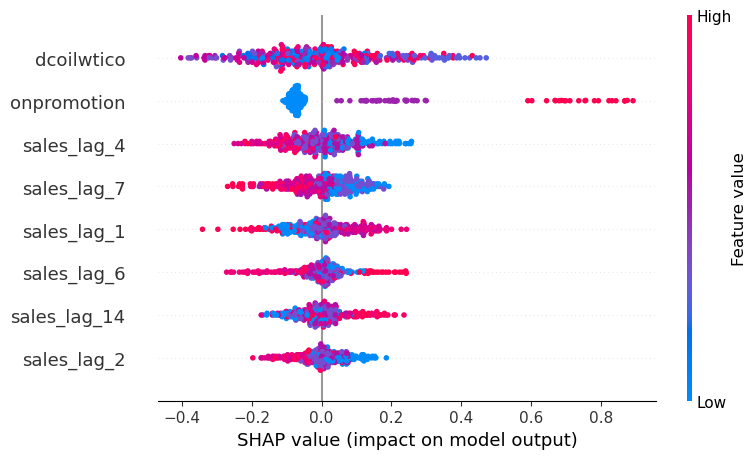

10, seafood


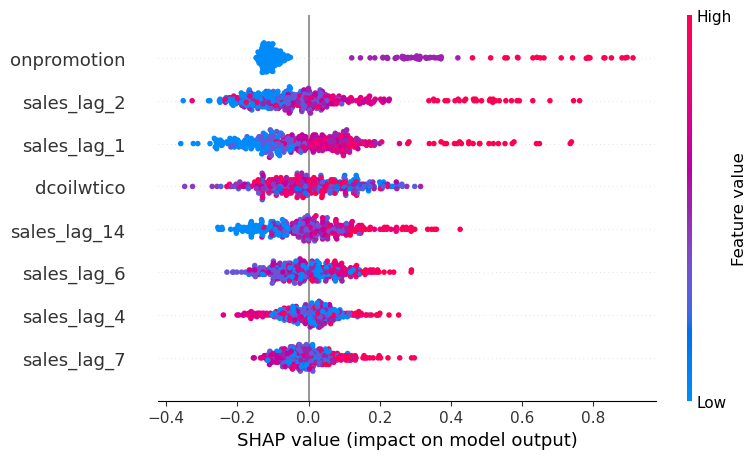

53, seafood


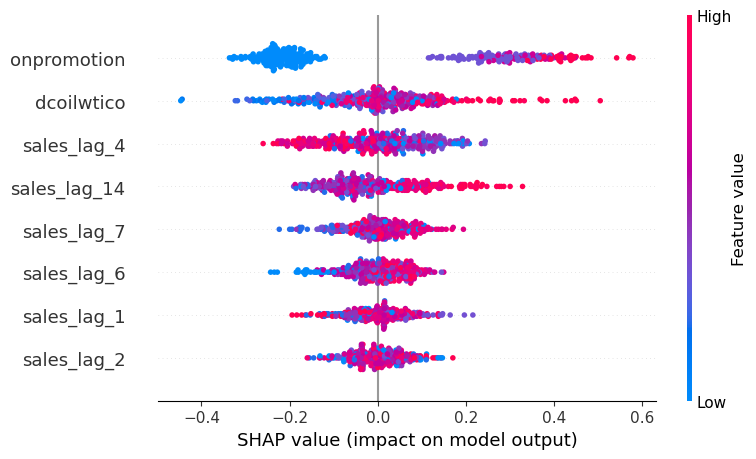

26, seafood


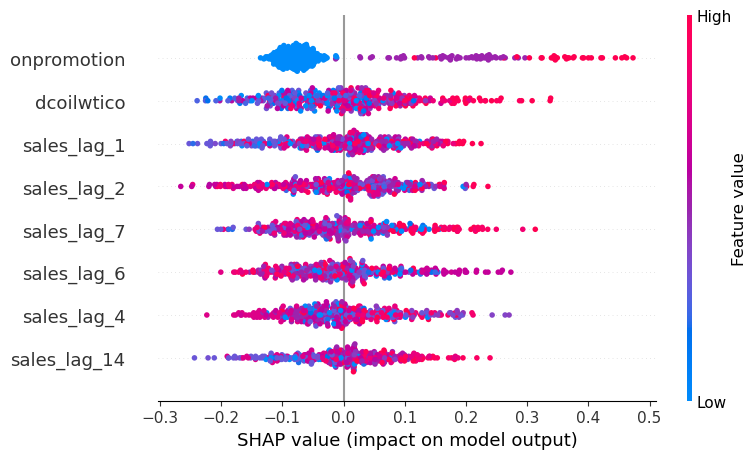

In [43]:
for current_ts in bad_rmsle_scores_ts_sorted.keys():
    print(f'{current_ts[0]}, {current_ts[1]}')
    X_current_ts = X_train_last_fold[(X_train_last_fold['family'] == current_ts[1]) & 
                                     (X_train_last_fold['store_nbr'] == int(current_ts[0]))].drop(columns=['date', 'sales', 'family', 'store_nbr'])
    y_current_ts = y_train_last_fold.loc[X_current_ts.index]
    
    lgbm_model = lgb.LGBMRegressor()
    lgbm_model.fit(X_current_ts, np.log1p(y_current_ts))
    explainer = shap.TreeExplainer(lgbm_model)
    shap_values_current_ts = explainer(X_current_ts)
    shap.summary_plot(shap_values_current_ts)

<b><p>8) 'onpromotion' feature has a very small impact on model output (by SHAP) of the 'celebration' category in these summary_plots. It was shown above that LGBM feature_importance of 'onpromotion' for this category was also very small. Probably, this feature is the reason, why model makes mistakes on 'celebration' category and it is necessary to remove this feature for this category.</p>
   <p><p>   The same situation with 'ladieswear', 'lawn and garden', 'lingerie' (in most stores) categories.</p>

### Waterfall plots for 'lingerie' category

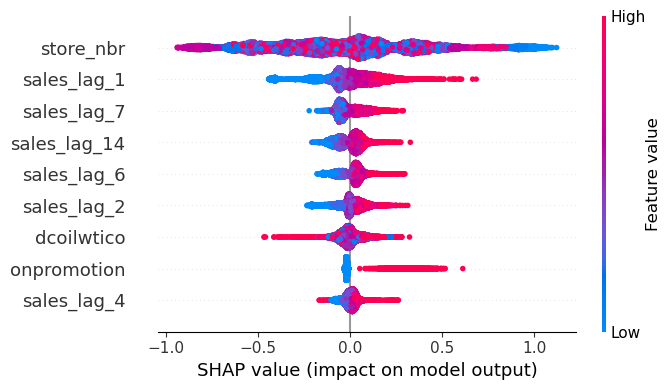

In [44]:
X_lingerie = X_train_last_fold[X_train_last_fold['family'] == 'lingerie'].drop(columns=['date', 'sales', 'family'])
y_lingerie = y_train_last_fold.loc[X_lingerie.index]
lgbm_model = lgb.LGBMRegressor()
lgbm_model.fit(X_lingerie, np.log1p(y_lingerie), categorical_feature=['store_nbr'])
explainer = shap.TreeExplainer(lgbm_model)
shap_values_lingerie = explainer(X_lingerie)
shap.summary_plot(shap_values_lingerie, plot_size=(7, 4))

date: 2016-12-02
store_nbr: 38
index: 6781


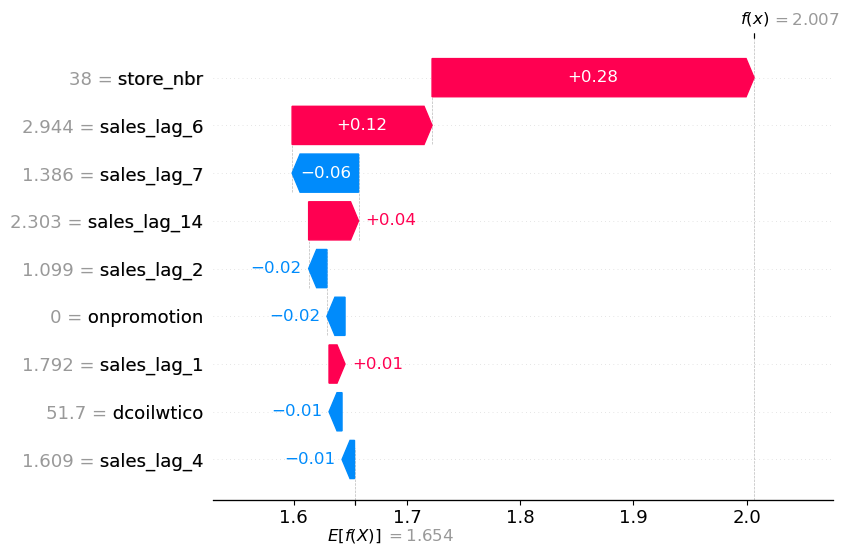

date: 2017-07-10
store_nbr: 31
index: 18600


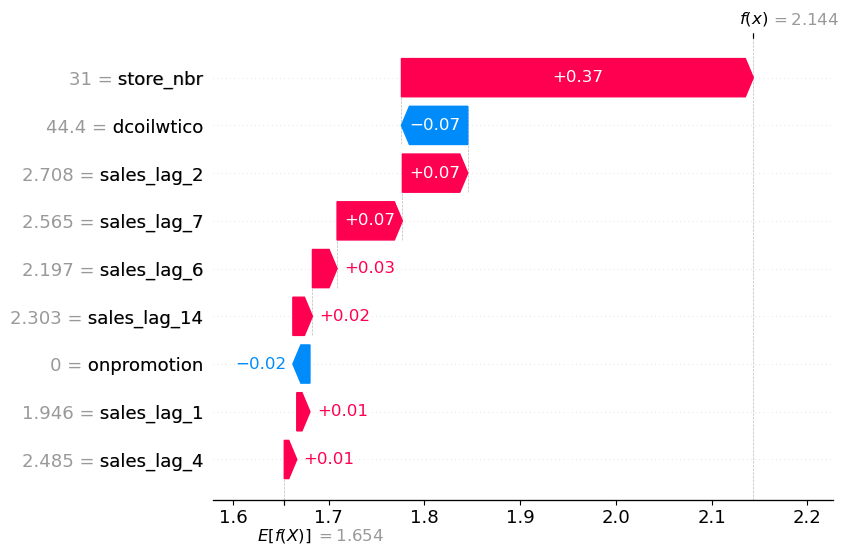

date: 2017-01-10
store_nbr: 6
index: 8852


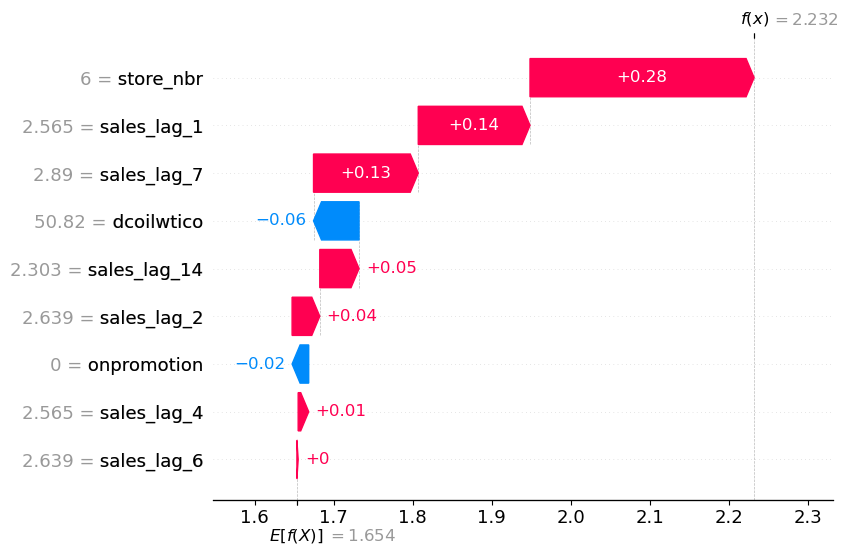

date: 2016-10-06
store_nbr: 19
index: 3682


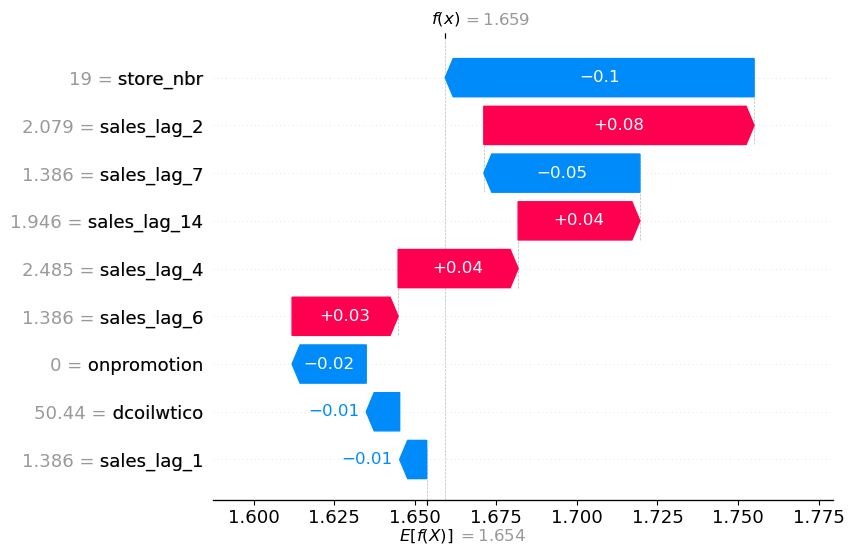

date: 2017-06-29
store_nbr: 50
index: 18027


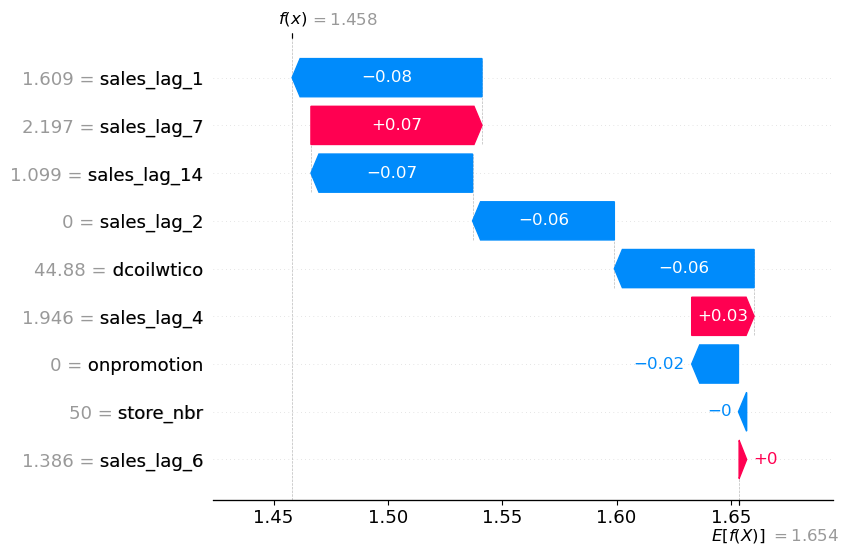

date: 2017-06-12
store_nbr: 13
index: 17068


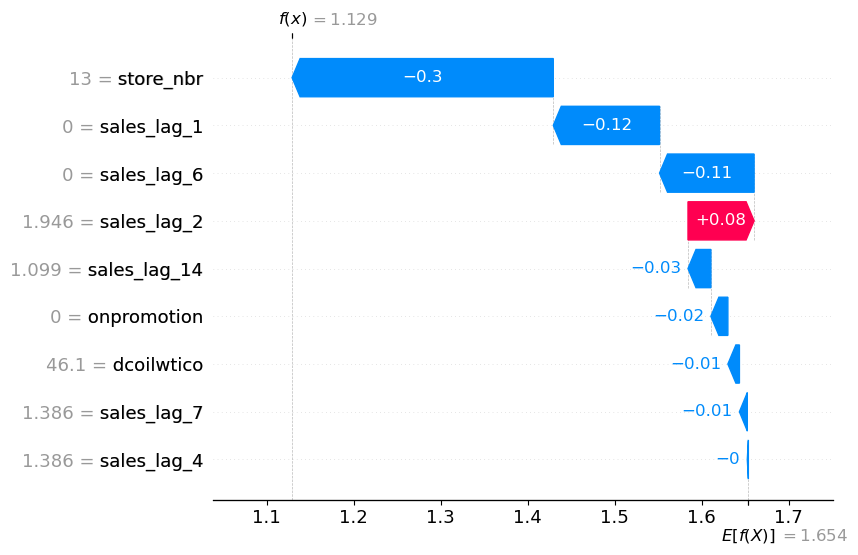

date: 2017-07-02
store_nbr: 26
index: 18162


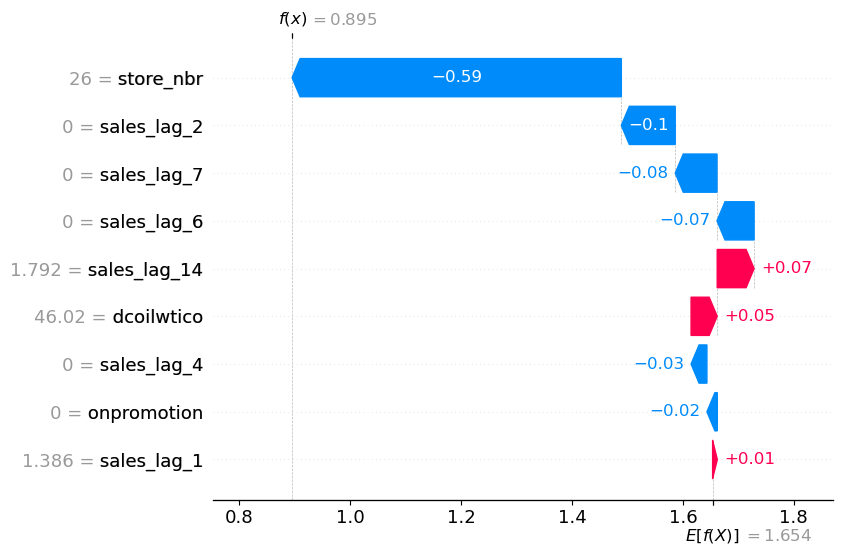

date: 2017-01-28
store_nbr: 2
index: 9785


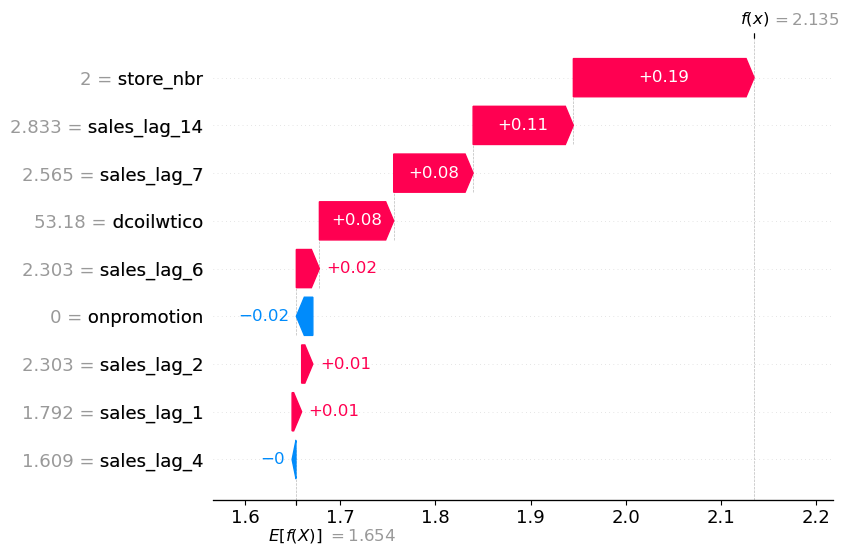

date: 2017-02-27
store_nbr: 47
index: 11435


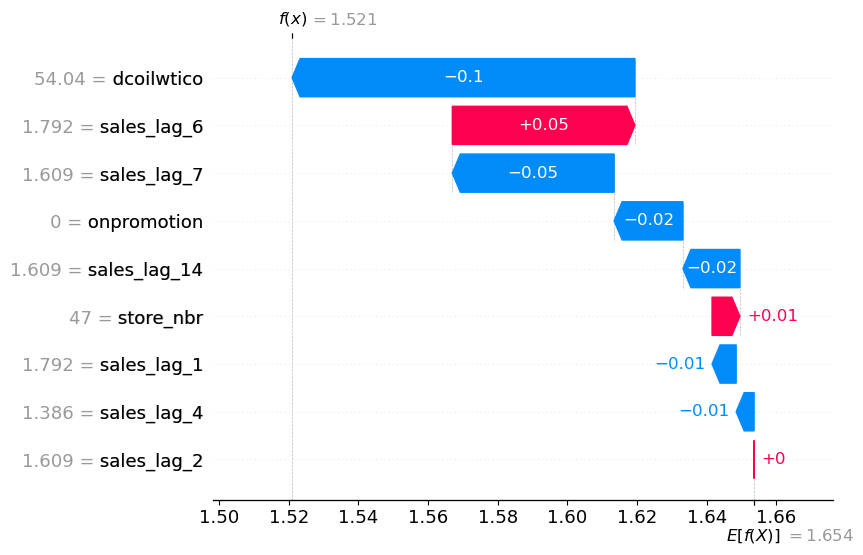

date: 2016-10-29
store_nbr: 5
index: 4958


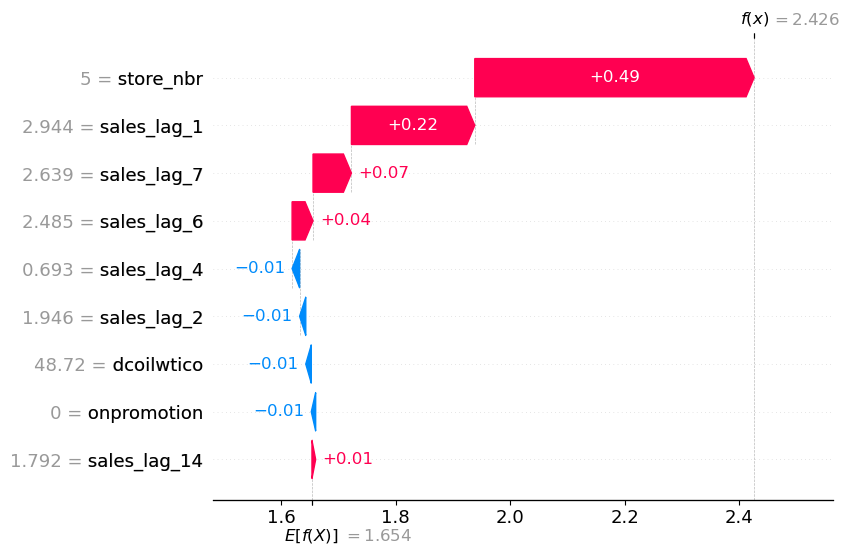

In [45]:
### waterfall plots for N=10 random 'lingerie' samples (to understand which features influence badly on predictions)

X_lingerie = X_train_last_fold[X_train_last_fold['family'] == 'lingerie'].reset_index()
random_samples = X_lingerie.sample(n=10)
for current_sample in random_samples.index:
    print('date:', random_samples['date'][current_sample])
    print('store_nbr:', random_samples['store_nbr'][current_sample])
    print('index:', current_sample)
    shap.plots.waterfall(shap_values_lingerie[current_sample])

### Changes in the best model according to the error analysis

In [46]:
# filling missing values for 18-th and 25-th store_nbr using linear regression predictions

X_nan_inds = X[X.isnull().any(axis=1)].index
X = X.dropna().reset_index(drop=True)
y = y.drop(index=X_nan_inds).reset_index(drop=True)

missing_data_18 = X[(X['store_nbr'] == 18) & (X['date'] >= '2016-08-15') & (X['date'] <= '2016-12-02')].index
missing_data_25 = X[(X['store_nbr'] == 25) & (X['date'] >= '2016-08-22') & (X['date'] <= '2016-10-26')].index


base_pipelines_18_25 = {}
for current_family in X['family'].unique():
    base_pipelines_18_25[current_family] = LinearPipeline(cols_to_scale=['dcoilwtico'], drop_columns=['onpromotion'], 
                                                          lags=lags, split_key='family', target_col='sales', level='store_nbr')

linear_pipeline = RecursiveTSEstimator(split_key='family', target_col='sales', base_pipelines=base_pipelines_18_25, 
                                       zero_categories=['baby care', 'books'])
    
X_train_linreg_18, X_train_linreg_25 = X[(X['store_nbr'] == 18) & (X['date'] >= '2015-08-15') & (X['date'] < '2016-08-15')], \
                                       X[(X['store_nbr'] == 25) & (X['date'] >= '2015-08-22') & (X['date'] < '2016-08-22')]
y_train_linreg_18, y_train_linreg_25 = y.loc[X_train_linreg_18.index], y.loc[X_train_linreg_25.index]
X_test_linreg_18, X_test_linreg_25 = X.loc[missing_data_18], X.loc[missing_data_25]

linear_pipeline.fit(X_train_linreg_18, y_train_linreg_18)
preds_18 = linear_pipeline.predict(X_test_linreg_18)
X.loc[missing_data_18, 'sales'] = np.log1p(preds_18)
y.loc[missing_data_18] = preds_18

linear_pipeline.fit(X_train_linreg_25, y_train_linreg_25)
preds_25 = linear_pipeline.predict(X_test_linreg_25)
X.loc[missing_data_25, 'sales'] = np.log1p(preds_25)
y.loc[missing_data_25] = preds_25

In [47]:
fit_params = {'categorical_feature': [0]}
tscv_inner = TimeSeriesSplit(gap=0, max_train_size=(DAYS_IN_YEAR - 4 * N_HORIZONS) * N_STORES, n_splits=4,
                             test_size=N_HORIZONS * N_STORES)
train_indices = next(splitter.split(X, y))[0]
X_train_first_fold, y_train_first_fold = X.iloc[train_indices], y.iloc[train_indices]

best_cv_params_edited = tune_hyperparams(X_train_first_fold, y_train_first_fold, tscv_inner=tscv_inner, lags=lags, 
                                         level='store_nbr', fit_params=fit_params, use_rmsle=True)

root_mean_squared_log_error: 0.432 ± 0.006
root_mean_squared_error: 308.542 ± 17.203
mean_absolute_error: 80.082 ± 3.737
r2: 0.943 ± 0.005


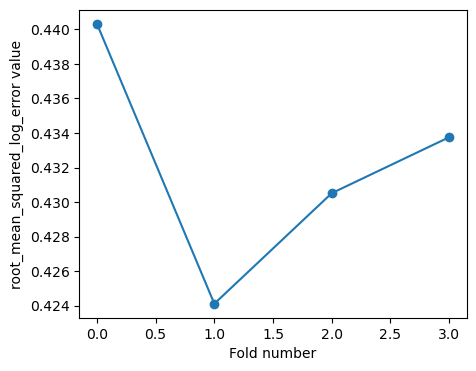

In [48]:
base_pipelines = {}
for current_family in X['family'].unique():
    if current_family in linear_categories:
        base_pipelines[current_family] = LinearPipeline(cols_to_scale=['dcoilwtico'], cols_to_encode=['store_nbr'], 
                                                        drop_columns=['onpromotion'], lags=lags, split_key='family', 
                                                        target_col='sales', level='store_nbr')
    else:
        base_pipelines[current_family] = LGBMPipeline(lags=lags, split_key='family', target_col='sales', level='store_nbr',
                                                      params=best_cv_params_edited[current_family], fit_params=fit_params)


modelling_pipeline = RecursiveTSEstimator(split_key='family', target_col='sales', base_pipelines=base_pipelines, 
                                          zero_categories=['baby care', 'books'])

scores = cross_validate(modelling_pipeline, X, y, cv=splitter, scoring=CV_METRICS, return_estimator=True, error_score='raise', 
                        n_jobs=-1)
format_cv_test_scores(scores, metrics_to_plot=['root_mean_squared_log_error'])

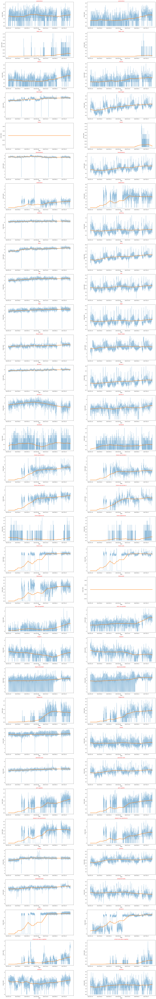

In [49]:
### time series plot for 18-th and 25-th 'store_nbr' (those with holes in the data)

plt.figure(figsize=(30, 200))
for i, family in enumerate(X['family'].unique()):
    plt.subplot(33, 2, 2 * i + 1)
    average_sales = X[(X['family'] == family) & (X['store_nbr'] == 18)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(family, color='red')
    
    plt.subplot(33, 2, 2 * i + 2)
    average_sales = X[(X['family'] == family) & (X['store_nbr'] == 25)].groupby('date')['sales'].median()
    trend = average_sales.rolling(window=365, center=True, min_periods=183).mean()
    plt.ylabel('mean sales')
    ax = average_sales.plot(alpha=0.5)
    ax = trend.plot(ax=ax, linewidth=3)
    plt.title(family, color='red')

In [50]:
# saving the predictions of the best model

linear_categories = ['baby care', 'books', 'lawn and garden', 'home appliances']
fit_params = {'categorical_feature': [0]}

X_train, y_train = cut_history(X=X, date_column='date', keep_interval=pd.Timedelta(days=DAYS_IN_YEAR), y=y)

base_pipelines = {}
for current_family in X['family'].unique():
    if current_family in linear_categories:
        base_pipelines[current_family] = LinearPipeline(cols_to_scale=['dcoilwtico'], cols_to_encode=['store_nbr'], 
                                                        drop_columns=['onpromotion'], lags=lags, split_key='family', 
                                                        target_col='sales', level='store_nbr')
    else:
        base_pipelines[current_family] = LGBMPipeline(lags=lags, split_key='family', target_col='sales', level='store_nbr',
                                                       fit_params=fit_params, params=best_final_params[current_family])

final_modelling_pipeline = RecursiveTSEstimator(split_key='family', target_col='sales', 
                                                base_pipelines=base_pipelines, 
                                                zero_categories=['baby care', 'books'])
final_modelling_pipeline.fit(X_train, y_train)
submission = pd.read_csv(DATA_ROOT / 'sample_submission.csv')
submission['sales'] = final_modelling_pipeline.predict(test_data)

In [51]:
X_train_store_52 = X_train[(X_train['store_nbr'] == 52) & (X_train['date'] >= '2017-04-20')]
y_train_store_52 = y_train.loc[X_train_store_52.index]

In [52]:
# hyperparameters tuning for 52-nd store_nbr

tscv_inner = TimeSeriesSplit(gap=0, n_splits=2, max_train_size=X_train_store_52['date'].nunique() - 2 * N_HORIZONS,
                             test_size=N_HORIZONS)
best_params_52 = tune_hyperparams(X_train_store_52, y_train_store_52, tscv_inner=tscv_inner, level='store_nbr', lags=lags, 
                                  drop_columns={family: ['store_nbr'] for family in X['family'].unique()}, use_rmsle=True)

In [54]:
# making predictions for 52-nd store_nbr

base_pipelines_52 = {}
for current_family in X['family'].unique():
    if current_family in linear_categories:
        base_pipelines_52[current_family] = LinearPipeline(cols_to_scale=['dcoilwtico'], drop_columns=['onpromotion'], 
                                                           lags=lags, split_key='family', target_col='sales', level='store_nbr')
    else:
        base_pipelines_52[current_family] = LGBMPipeline(lags=lags, split_key='family', target_col='sales', level='store_nbr',
                                                         params=best_params_52[current_family])

modelling_pipeline_52 = RecursiveTSEstimator(split_key='family', target_col='sales', 
                                             base_pipelines=base_pipelines_52, 
                                             zero_categories=['baby care', 'books'])
modelling_pipeline_52.fit(X_train_store_52, y_train_store_52)
preds_store_52 = modelling_pipeline_52.predict(test_data[test_data['store_nbr'] == 52])
submission.loc[test_data[test_data['store_nbr'] == 52].index, 'sales'] = preds_store_52

[LightGBM] [Warning] min_data_in_leaf is set=410, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=410
[LightGBM] [Warning] min_gain_to_split is set=10.886507357613523, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.886507357613523
[LightGBM] [Warning] lambda_l1 is set=1.0976106893797954e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0976106893797954e-07
[LightGBM] [Warning] lambda_l2 is set=0.00015022883993790303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00015022883993790303


In [55]:
submission.to_csv(DATA_ROOT / 'best_model_preds.csv', index=False)